In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [4]:
df = pd.read_csv("C:/Users/singh/OneDrive/Documents/Steam Games 2024.csv")

C:\Users\singh\AppData\Local\Temp\ipykernel_8216\3585741852.py:1: DtypeWarning: Columns (0,4,5,6,7,8,17,18,19,20,22,23,24,25,26,27,29,30,31,32) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv("C:/Users/singh/OneDrive/Documents/Steam Games 2024.csv")


In [6]:
df.head(3)

,AppID,Name,Release date,Estimated owners,Peak CCU,Required age,Price,Discount,DLC count,About the game,...,Average playtime two weeks,Median playtime forever,Median playtime two weeks,Developers,Publishers,Categories,Genres,Tags,Screenshots,Movies
0,20200,Galactic Bowling,"Oct 21, 2008",0 - 20000,0,0,19.99,0,0,Galactic Bowling is an exaggerated and stylize...,...,0,0,0,Perpetual FX Creative,Perpetual FX Creative,"Single-player,Multi-player,Steam Achievements,...","Casual,Indie,Sports","Indie,Casual,Sports,Bowling",https://cdn.akamai.steamstatic.com/steam/apps/...,http://cdn.akamai.steamstatic.com/steam/apps/2...
1,655370,Train Bandit,"Oct 12, 2017",0 - 20000,0,0,0.99,0,0,THE LAW!! Looks to be a showdown atop a train....,...,0,0,0,Rusty Moyher,Wild Rooster,"Single-player,Steam Achievements,Full controll...","Action,Indie","Indie,Action,Pixel Graphics,2D,Retro,Arcade,Sc...",https://cdn.akamai.steamstatic.com/steam/apps/...,http://cdn.akamai.steamstatic.com/steam/apps/2...
2,1732930,Jolt Project,"Nov 17, 2021",0 - 20000,0,0,4.99,0,0,Jolt Project: The army now has a new robotics ...,...,0,0,0,CampiÃ£o Games,CampiÃ£o Games,Single-player,"Action,Adventure,Indie,Strategy",NaN,https://cdn.akamai.steamstatic.com/steam/apps/...,http://cdn.akamai.steamstatic.com/steam/apps/2...


In [10]:
df.shape

(97428, 40)

In [12]:
# Convert columns to appropriate data types
df['AppID'] = pd.to_numeric(df['AppID'], errors='coerce')
df['Release date'] = pd.to_datetime(df['Release date'], errors='coerce')
df['Estimated owners'] = df['Estimated owners'].astype(str)
df['Peak CCU'] = pd.to_numeric(df['Peak CCU'], errors='coerce')
df['Required age'] = pd.to_numeric(df['Required age'], errors='coerce')
df['Price'] = pd.to_numeric(df['Price'], errors='coerce')
df['Discount'] = pd.to_numeric(df['Discount'], errors='coerce') 
df['DLC count'] = pd.to_numeric(df['DLC count'], errors='coerce')
df['Windows'] = df['Windows'].astype(bool)
df['Mac'] = df['Mac'].astype(bool)
df['Linux'] = df['Linux'].astype(bool)
df['Metacritic score'] = pd.to_numeric(df['Metacritic score'], errors='coerce')
df['User score'] = pd.to_numeric(df['User score'], errors='coerce')
df['Positive'] = pd.to_numeric(df['Positive'], errors='coerce')
df['Negative'] = pd.to_numeric(df['Negative'], errors='coerce')
df['Achievements'] = pd.to_numeric(df['Achievements'], errors='coerce')
df['Recommendations'] = pd.to_numeric(df['Recommendations'], errors='coerce')
df['Average playtime forever'] = pd.to_numeric(df['Average playtime forever'], errors='coerce')
df['Average playtime two weeks'] = pd.to_numeric(df['Average playtime two weeks'], errors='coerce')
df['Median playtime forever'] = pd.to_numeric(df['Median playtime forever'], errors='coerce')
df['Median playtime two weeks'] = pd.to_numeric(df['Median playtime two weeks'], errors='coerce')

df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 97428 entries, 0 to 97427
Data columns (total 40 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   AppID                       97410 non-null  float64       
 1   Name                        97412 non-null  object        
 2   Release date                97279 non-null  datetime64[ns]
 3   Estimated owners            97428 non-null  object        
 4   Peak CCU                    97410 non-null  float64       
 5   Required age                97410 non-null  float64       
 6   Price                       97410 non-null  float64       
 7   Discount                    97410 non-null  float64       
 8   DLC count                   97410 non-null  float64       
 9   About the game              92537 non-null  object        
 10  Supported languages         97410 non-null  object        
 11  Full audio languages        97410 non-null  object    

In [14]:
df.isna().sum()

AppID                            18
Name                             16
Release date                    149
Estimated owners                  0
Peak CCU                         18
Required age                     18
Price                            18
Discount                         18
DLC count                        18
About the game                 4891
Supported languages              18
Full audio languages             18
Reviews                       87296
Header image                     19
Website                       54683
Support url                   51523
Support email                 16054
Windows                           0
Mac                               0
Linux                             0
Metacritic score                 25
Metacritic url                93467
User score                       24
Positive                         24
Negative                         25
Score rank                    97376
Achievements                     26
Recommendations             

## Data Cleaning

In [17]:
#creating a copy
df_copy = df.copy()

### Dealing with null values in AppID column 

In [20]:
df.loc[df['AppID'].isna()]

,AppID,Name,Release date,Estimated owners,Peak CCU,Required age,Price,Discount,DLC count,About the game,...,Average playtime two weeks,Median playtime forever,Median playtime two weeks,Developers,Publishers,Categories,Genres,Tags,Screenshots,Movies
75724,NaN,['Simplified Chinese'],NaT,nan,NaN,NaN,NaN,NaN,NaN,FALSE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
79460,NaN,NaN,NaT,nan,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
79461,NaN,ä»çŽ‹2,NaT,å¥³ç¥žå¼‚é—»å½•5,NaN,NaN,NaN,NaN,NaN,ç»åœ°æ±‚ç”Ÿ,...,NaN,NaN,NaN,æˆ˜äº‰,æ¢¦å¹»å®¶å›­,åŠ¨ä½œæ¸¸æˆ,æ—¶ç©ºå¬å”¤,ä¹±ä¸–çŽ‹è€…,æ¸¸æˆå¤§å…¨,å¯»ä»™
79486,NaN,NaN,NaT,nan,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
79487,NaN,ä»çŽ‹2,NaT,å¥³ç¥žç•°èžéŒ„5,NaN,NaN,NaN,NaN,NaN,çµ•åœ°æ±‚ç”Ÿ,...,NaN,NaN,NaN,æˆ°çˆ­,å¤¢å¹»å®¶åœ’,å‹•ä½œéŠæˆ²,æ™‚ç©ºå¬å–š,äº‚ä¸–çŽ‹è€…,éŠæˆ²å¤§å…¨,å°‹ä»™
82884,NaN,NaN,NaT,nan,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
82885,NaN,ä»çŽ‹2,NaT,å¥³ç¥žå¼‚é—»å½•5,NaN,NaN,NaN,NaN,NaN,ç»åœ°æ±‚ç”Ÿ,...,NaN,NaN,NaN,æˆ˜äº‰,æ¢¦å¹»å®¶å›­,åŠ¨ä½œæ¸¸æˆ,æ—¶ç©ºå¬å”¤,ä¹±ä¸–çŽ‹è€…,æ¸¸æˆå¤§å…¨,å¯»ä»™
83386,NaN,é­”æ³•æ¸¸æˆ,NaT,å†›äº‹æ¸¸æˆ,NaN,NaN,NaN,NaN,NaN,ç±»é“¶æ²³æˆ˜å£«æ¶é­”åŸŽæ¸¸æˆ,...,NaN,NaN,NaN,è’¸æ±½æœ‹å…‹æ¸¸æˆ,ç«žæŠ€åœºå°„å‡»æ¸¸æˆ,æ¯ç­æ¸¸æˆ,å¤šäººåœ¨çº¿æˆ˜æœ¯ç«žæŠ€æ¸¸æˆ,äº’åŠ¨å°è¯´æ¸¸æˆ,å¤§æˆ˜ç•¥æ¸¸æˆ,å¯»å®æ¸¸æˆ
84536,NaN,NaN,NaT,nan,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
84537,NaN,ä»çŽ‹2,NaT,å¥³ç¥žå¼‚é—»å½•5,NaN,NaN,NaN,NaN,NaN,ç»åœ°æ±‚ç”Ÿ,...,NaN,NaN,NaN,æˆ˜äº‰,æ¢¦å¹»å®¶å›­,åŠ¨ä½œæ¸¸æˆ,æ—¶ç©ºå¬å”¤,ä¹±ä¸–çŽ‹è€…,æ¸¸æˆå¤§å…¨,å¯»ä»™


In [22]:
df = df.dropna(subset=['AppID'])

In [24]:
df.shape

(97410, 40)

In [26]:
df.isna().sum()

AppID                             0
Name                              6
Release date                    131
Estimated owners                  0
Peak CCU                          0
Required age                      0
Price                             0
Discount                          0
DLC count                         0
About the game                 4881
Supported languages               8
Full audio languages              8
Reviews                       87285
Header image                      8
Website                       54673
Support url                   51513
Support email                 16043
Windows                           0
Mac                               0
Linux                             0
Metacritic score                  8
Metacritic url                93457
User score                        8
Positive                          8
Negative                          8
Score rank                    97366
Achievements                      8
Recommendations             

## Dealing with null values in Name column

In [29]:
df.loc[df['Name'].isna()].index

Index([25222, 72038, 77216, 77488, 77562, 77722], dtype='int64')

In [31]:
df = df.drop(df.loc[df['Name'].isna()].index)

In [33]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 97404 entries, 0 to 97427
Data columns (total 40 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   AppID                       97404 non-null  float64       
 1   Name                        97404 non-null  object        
 2   Release date                97273 non-null  datetime64[ns]
 3   Estimated owners            97404 non-null  object        
 4   Peak CCU                    97404 non-null  float64       
 5   Required age                97404 non-null  float64       
 6   Price                       97404 non-null  float64       
 7   Discount                    97404 non-null  float64       
 8   DLC count                   97404 non-null  float64       
 9   About the game              92528 non-null  object        
 10  Supported languages         97396 non-null  object        
 11  Full audio languages        97396 non-null  object        


### Dealing with null values in Release date column

In [36]:
# Dropping rows with missing 'Release Date' values is a reasonable approach because:
# 1. Small Percentage: With only 131 missing values out of approximately 97,000 rows, the percentage of missing data is quite small (about 0.14%).
# This means the removal of these rows will have a minimal impact on your overall dataset and analysis.
# 2. Irrelevance of Missing Data: Since the 'Release Date' is not dependent on or related to other columns, 
# there are no obvious means to infer or fill in these missing values meaningfully. Therefore, dropping these rows is a straightforward solution.
# 3. Simplicity: Removing these rows ensures that your dataset is clean and avoids complications in subsequent analysis or modeling 
# that might arise from handling missing dates.

df.dropna(subset=['Release date'], inplace=True)

In [38]:
df.isna().sum()

AppID                             0
Name                              0
Release date                      0
Estimated owners                  0
Peak CCU                          0
Required age                      0
Price                             0
Discount                          0
DLC count                         0
About the game                 4875
Supported languages               8
Full audio languages              8
Reviews                       87173
Header image                      8
Website                       54627
Support url                   51466
Support email                 16005
Windows                           0
Mac                               0
Linux                             0
Metacritic score                  8
Metacritic url                93336
User score                        8
Positive                          8
Negative                          8
Score rank                    97229
Achievements                      8
Recommendations             

## Dealing with null values in About the game column

In [41]:
df.isna().sum()

AppID                             0
Name                              0
Release date                      0
Estimated owners                  0
Peak CCU                          0
Required age                      0
Price                             0
Discount                          0
DLC count                         0
About the game                 4875
Supported languages               8
Full audio languages              8
Reviews                       87173
Header image                      8
Website                       54627
Support url                   51466
Support email                 16005
Windows                           0
Mac                               0
Linux                             0
Metacritic score                  8
Metacritic url                93336
User score                        8
Positive                          8
Negative                          8
Score rank                    97229
Achievements                      8
Recommendations             

In [43]:
df.loc[df['About the game'].isna()]

,AppID,Name,Release date,Estimated owners,Peak CCU,Required age,Price,Discount,DLC count,About the game,...,Average playtime two weeks,Median playtime forever,Median playtime two weeks,Developers,Publishers,Categories,Genres,Tags,Screenshots,Movies
105,1943590.0,æºªé£Žè°·ä¹‹æˆ˜ Playtest,2022-03-24,0 - 0,0.0,0.0,0.0,0.0,0.0,NaN,...,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
180,1966960.0,Burial Stone Playtest,2022-04-13,0 - 0,0.0,0.0,0.0,0.0,0.0,NaN,...,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,https://cdn.akamai.steamstatic.com/steam/apps/...,NaN
214,1688630.0,Emperial Knights Playtest,2021-11-14,0 - 0,0.0,0.0,0.0,0.0,0.0,NaN,...,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,https://cdn.akamai.steamstatic.com/steam/apps/...,NaN
220,1478660.0,Slotracers VR Playtest,2020-12-17,0 - 0,0.0,0.0,0.0,0.0,0.0,NaN,...,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
291,1613340.0,Pirates of the Asteroid Belt Playtest,2021-04-23,0 - 0,0.0,0.0,0.0,0.0,0.0,NaN,...,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97381,3043240.0,Feed The Gods Playtest,2024-08-06,0 - 0,0.0,0.0,0.0,0.0,0.0,NaN,...,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,https://shared.akamai.steamstatic.com/store_it...,NaN
97403,3182940.0,The Invading Dark Playtest,2024-08-27,0 - 0,0.0,0.0,0.0,0.0,0.0,NaN,...,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
97405,3167240.0,ä¸§å°¸å¡ç‰Œï¼šç”Ÿå­˜å¯¹å†³ Playtest,2024-08-21,0 - 0,0.0,0.0,0.0,0.0,0.0,NaN,...,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
97410,3027950.0,Karate Survivor Playtest,2024-08-14,0 - 0,0.0,0.0,0.0,0.0,0.0,NaN,...,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [44]:
df.loc[df['About the game'].isna(),"Name"]

105                   æºªé£Žè°·ä¹‹æˆ˜ Playtest
180                      Burial Stone Playtest
214                  Emperial Knights Playtest
220                     Slotracers VR Playtest
291      Pirates of the Asteroid Belt Playtest
                         ...                  
97381                   Feed The Gods Playtest
97403               The Invading Dark Playtest
97405     ä¸§å°¸å¡ç‰Œï¼šç”Ÿå­˜å¯¹å†³ Playtest
97410                 Karate Survivor Playtest
97422                          Carbon Playtest
Name: Name, Length: 4875, dtype: object

In [47]:
# most of the games that dont have description are playtest
df.loc[df["Name"].str.contains('Playtest'),'About the game'] = "this is a playtest game is the process by which a game designer tests a new game for bugs and design flaws before releasing it to market."

In [49]:
df.isna().sum()

AppID                             0
Name                              0
Release date                      0
Estimated owners                  0
Peak CCU                          0
Required age                      0
Price                             0
Discount                          0
DLC count                         0
About the game                  236
Supported languages               8
Full audio languages              8
Reviews                       87173
Header image                      8
Website                       54627
Support url                   51466
Support email                 16005
Windows                           0
Mac                               0
Linux                             0
Metacritic score                  8
Metacritic url                93336
User score                        8
Positive                          8
Negative                          8
Score rank                    97229
Achievements                      8
Recommendations             

In [51]:
df.loc[df['About the game'].isna(),"Name"]

956                                  Project Scav
1118                                      Abode 2
1377                           NARAKA: BLADEPOINT
3208                               Hello, Goodbye
3399                              Theatre of Doom
                           ...                   
96746                                   Prisoners
96834    Warhammer: Vermintide Versus - Open Beta
96908                      DOOM Eternal: idStudio
97190                Trials of Innocence PlayTest
97253                 Thank Goodness You're Here!
Name: Name, Length: 236, dtype: object

In [53]:
# There are only 237 games left. I explored them and found certain words that are repeating. 
# I dealt with them, and then there are a few games left without a description.
# For any beta game, the null value is replaced with 'This game is beta and still under testing.'
# For any Alpha game, the null value is replaced with 'This game is Alpha and still under testing.'
# For any Test game, the null value is replaced with 'This game is Test and still under testing.'
# For any playtest game, the null value is replaced with 'This game is playtest and still under testing.'
# For any SDK game, the null value is replaced with 'This game is SDK and still under testing.'
# For any Demo game, the null value is replaced with 'This game is Demo and still under testing.'
# For any server game, the null value is replaced with 'This game is server and still under testing.'
# For any editor game, the null value is replaced with 'This game is Editor and still under testing.'

for index, row in df.iterrows():
    if(pd.isnull(row['About the game'])):
        if 'Beta' in row['Name']:
            df.at[index, 'About the game'] = 'this game is beta and still under testing'
        elif "Alpha" in row['Name']:
            df.at[index, 'About the game'] = 'this game is Alpha and still under testing'
        elif "beta" in row['Name']:
            df.at[index, 'About the game'] = 'this game is beta and still under testing'
        elif "BETA" in row['Name']:
            df.at[index, 'About the game'] = 'this game is beta and still under testing'
        elif "Test" in row['Name']:
            df.at[index, 'About the game'] = 'this game is and still under testing'
        elif "playtest" in row['Name']:
            df.at[index, 'About the game'] = 'this game is still under testing'
        elif "SDK" in row['Name']:
            df.at[index, 'About the game'] = 'Software Development Kit of the game'
        elif "Demo" in row['Name']:
            df.at[index, 'About the game'] = 'this game is Demo and still under testing'
        elif "Server" in row['Name']:
            df.at[index, 'About the game'] = 'this is a Server for the game'
        elif "Editor" in row['Name']:
            df.at[index, 'About the game'] = 'this is an Editor for the game'
        else:
            df.at[index, 'About the game'] = 'this game does not have a description'
             

In [54]:
df.isna().sum()

AppID                             0
Name                              0
Release date                      0
Estimated owners                  0
Peak CCU                          0
Required age                      0
Price                             0
Discount                          0
DLC count                         0
About the game                    0
Supported languages               8
Full audio languages              8
Reviews                       87173
Header image                      8
Website                       54627
Support url                   51466
Support email                 16005
Windows                           0
Mac                               0
Linux                             0
Metacritic score                  8
Metacritic url                93336
User score                        8
Positive                          8
Negative                          8
Score rank                    97229
Achievements                      8
Recommendations             

### Dealing with null values in Supported languages and Full audio languages

In [56]:
df.loc[df['Supported languages'].isna() | df['Full audio languages'].isna()]

,AppID,Name,Release date,Estimated owners,Peak CCU,Required age,Price,Discount,DLC count,About the game,...,Average playtime two weeks,Median playtime forever,Median playtime two weeks,Developers,Publishers,Categories,Genres,Tags,Screenshots,Movies
75723,2482450.0,åŽå‘åˆ¶äºº,2023-07-11,0 - 0,0.0,0.0,0.00,0.0,0.0,this game does not have a description,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
79459,2520880.0,ä¹±ç«æˆ˜èˆž,2023-09-07,0 - 0,0.0,0.0,0.00,0.0,0.0,this game does not have a description,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
79485,2642660.0,æœ«æ—¥æˆ˜å§¬-äºŒæ¬¡å…ƒ.ç­–ç•¥.å¡ç‰Œ.æ¸¸æˆ,2023-11-16,0 - 0,0.0,0.0,0.00,0.0,0.0,this game does not have a description,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
82883,2445600.0,ç¥žæ˜Žä¹‹æ—…,2023-09-21,0 - 0,0.0,0.0,0.00,0.0,0.0,this game does not have a description,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
83385,2532200.0,Be The Richest,2023-08-14,0 - 0,0.0,0.0,0.00,0.0,0.0,this game does not have a description,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
84535,2389120.0,æˆ˜å§¬å†›å›¢,2023-12-18,0 - 0,0.0,0.0,0.00,0.0,0.0,this game does not have a description,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
92050,2763490.0,Traverse the Backrooms,2024-05-24,0 - 0,0.0,0.0,6.99,0.0,0.0,this game does not have a description,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
93730,3001050.0,è½¬ç”Ÿæˆä¸ºå°èœé¸¡,2024-06-10,0 - 0,0.0,0.0,0.00,0.0,0.0,this game does not have a description,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [57]:
df.loc[df['Name'].isna()].index

Index([], dtype='int64')

In [58]:
df = df.dropna(subset=['Supported languages'])

In [59]:
df.isna().sum()

AppID                             0
Name                              0
Release date                      0
Estimated owners                  0
Peak CCU                          0
Required age                      0
Price                             0
Discount                          0
DLC count                         0
About the game                    0
Supported languages               0
Full audio languages              0
Reviews                       87165
Header image                      0
Website                       54619
Support url                   51458
Support email                 15997
Windows                           0
Mac                               0
Linux                             0
Metacritic score                  0
Metacritic url                93328
User score                        0
Positive                          0
Negative                          0
Score rank                    97221
Achievements                      0
Recommendations             

### Dealing with Reviews column

In [61]:
df["Reviews"].unique()

array([nan,
       "â€œNew WW2 Strategy Game Offers A Harrowing Look At Poland's Ill-Fated 1944 Uprisingâ€\x9d GameSpot â€œ(â€¦) in execution Warsaw manages to deliver its own experience entirely.â€\x9d Dualshockers â€œ(â€¦) Beautiful hand-painted artwork and turn-based combat (â€¦)â€\x9d Gameinformer",
       'â€œThe art in Cthulhu Realms is hilarious and beautifully done, somehow complimenting the horror theme perfectly. The production value is top-notch.â€\x9d Gameosity â€œItâ€™s a surprisingly effective package that delivers a great little deck builder with a low price tag. If you can embrace the playful theme, youâ€™ll find a pleasant gem in Cthulhu Realms.â€\x9d Geek Ken â€œIt certainly is not just another deck-building game, but has original and fresh mechanics that will challenge your brain.â€\x9d Board Game Maniac',
       ...,
       "â€œNext of Kin may very well be named the 'surprise of the year' when the gaming year 2024 is summed up at the end of the year.â€\x9d 9/10 â€“ 

In [62]:
df = df.drop('Reviews', axis=1)

In [63]:
df.isna().sum()

AppID                             0
Name                              0
Release date                      0
Estimated owners                  0
Peak CCU                          0
Required age                      0
Price                             0
Discount                          0
DLC count                         0
About the game                    0
Supported languages               0
Full audio languages              0
Header image                      0
Website                       54619
Support url                   51458
Support email                 15997
Windows                           0
Mac                               0
Linux                             0
Metacritic score                  0
Metacritic url                93328
User score                        0
Positive                          0
Negative                          0
Score rank                    97221
Achievements                      0
Recommendations                   0
Notes                       

## convert windows , Mac , Linux to one column 

In [65]:
df["Windows"]

0        True
1        True
2        True
3        True
4        True
         ... 
97423    True
97424    True
97425    True
97426    True
97427    True
Name: Windows, Length: 97265, dtype: bool

In [66]:
# creating new column OS
for index, row in df.iterrows():
    if row["Windows"] == True:
        df.at[index, 'OS'] = "Windows"
        if row["Mac"] == True:
            df.at[index, 'OS'] = "Windows, Mac"
            if row["Linux"] == True:
                df.at[index, 'OS'] = "Windows, Mac, Linux"
        elif row["Linux"] == True:
            df.at[index, 'OS'] = "Windows, Linux"
    elif row["Windows"] == False and row["Mac"] == True:
        df.at[index, 'OS'] = "Mac"
        if row["Linux"] == True:
            df.at[index, 'OS'] = "Windows, Linux"
    elif row["Windows"] == False and row["Mac"] == False and row["Linux"] == True:
        df.at[index, 'OS'] = "Linux"

In [67]:
df.head(5)

,AppID,Name,Release date,Estimated owners,Peak CCU,Required age,Price,Discount,DLC count,About the game,...,Median playtime forever,Median playtime two weeks,Developers,Publishers,Categories,Genres,Tags,Screenshots,Movies,OS
0,20200.0,Galactic Bowling,2008-10-21,0 - 20000,0.0,0.0,19.99,0.0,0.0,Galactic Bowling is an exaggerated and stylize...,...,0.0,0.0,Perpetual FX Creative,Perpetual FX Creative,"Single-player,Multi-player,Steam Achievements,...","Casual,Indie,Sports","Indie,Casual,Sports,Bowling",https://cdn.akamai.steamstatic.com/steam/apps/...,http://cdn.akamai.steamstatic.com/steam/apps/2...,Windows
1,655370.0,Train Bandit,2017-10-12,0 - 20000,0.0,0.0,0.99,0.0,0.0,THE LAW!! Looks to be a showdown atop a train....,...,0.0,0.0,Rusty Moyher,Wild Rooster,"Single-player,Steam Achievements,Full controll...","Action,Indie","Indie,Action,Pixel Graphics,2D,Retro,Arcade,Sc...",https://cdn.akamai.steamstatic.com/steam/apps/...,http://cdn.akamai.steamstatic.com/steam/apps/2...,"Windows, Mac"
2,1732930.0,Jolt Project,2021-11-17,0 - 20000,0.0,0.0,4.99,0.0,0.0,Jolt Project: The army now has a new robotics ...,...,0.0,0.0,CampiÃ£o Games,CampiÃ£o Games,Single-player,"Action,Adventure,Indie,Strategy",NaN,https://cdn.akamai.steamstatic.com/steam/apps/...,http://cdn.akamai.steamstatic.com/steam/apps/2...,Windows
3,1355720.0,Henosisâ„¢,2020-07-23,0 - 20000,0.0,0.0,5.99,0.0,0.0,HENOSISâ„¢ is a mysterious 2D Platform Puzzler...,...,0.0,0.0,Odd Critter Games,Odd Critter Games,"Single-player,Full controller support","Adventure,Casual,Indie","2D Platformer,Atmospheric,Surreal,Mystery,Puzz...",https://cdn.akamai.steamstatic.com/steam/apps/...,http://cdn.akamai.steamstatic.com/steam/apps/2...,"Windows, Mac, Linux"
4,1139950.0,Two Weeks in Painland,2020-02-03,0 - 20000,0.0,0.0,0.00,0.0,0.0,ABOUT THE GAME Play as a hacker who has arrang...,...,0.0,0.0,Unusual Games,Unusual Games,"Single-player,Steam Achievements","Adventure,Indie","Indie,Adventure,Nudity,Violent,Sexual Content,...",https://cdn.akamai.steamstatic.com/steam/apps/...,http://cdn.akamai.steamstatic.com/steam/apps/2...,"Windows, Mac"


In [68]:
df.isnull().sum()

AppID                             0
Name                              0
Release date                      0
Estimated owners                  0
Peak CCU                          0
Required age                      0
Price                             0
Discount                          0
DLC count                         0
About the game                    0
Supported languages               0
Full audio languages              0
Header image                      0
Website                       54619
Support url                   51458
Support email                 15997
Windows                           0
Mac                               0
Linux                             0
Metacritic score                  0
Metacritic url                93328
User score                        0
Positive                          0
Negative                          0
Score rank                    97221
Achievements                      0
Recommendations                   0
Notes                       

In [70]:
# Change the datatype of 'Positive', 'Negative','Achievement','Metacritic score' 'User score','Recommendations', 
#'Average playtime forever', 'Average playtime two weeks', 'Median playtime forever', and 'Median playtime two weeks' 
#to int as they have now no null values.
df['Positive'] = df['Positive'].astype(int)
df['Negative'] = df['Negative'].astype(int)
df['Achievements'] = df['Achievements'].astype(int)
df['Metacritic score'] = df['Metacritic score'].astype(int)
df['User score'] = df['User score'].astype(int)
df['Recommendations'] = df['Recommendations'].astype(int)
df['Average playtime forever'] = df['Average playtime forever'].astype(int)
df['Average playtime two weeks'] = df['Average playtime two weeks'].astype(int)
df['Median playtime forever'] = df['Median playtime forever'].astype(int)
df['Median playtime two weeks'] = df['Median playtime two weeks'].astype(int)


In [75]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 97265 entries, 0 to 97427
Data columns (total 40 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   AppID                       97265 non-null  float64       
 1   Name                        97265 non-null  object        
 2   Release date                97265 non-null  datetime64[ns]
 3   Estimated owners            97265 non-null  object        
 4   Peak CCU                    97265 non-null  float64       
 5   Required age                97265 non-null  float64       
 6   Price                       97265 non-null  float64       
 7   Discount                    97265 non-null  float64       
 8   DLC count                   97265 non-null  float64       
 9   About the game              97265 non-null  object        
 10  Supported languages         97265 non-null  object        
 11  Full audio languages        97265 non-null  object        


In [80]:
df["Metacritic score"].unique()

array([ 0, 62, 64, 53, 84, 89, 70, 86, 40, 87, 92, 76, 51, 49, 81, 69, 72,
       68, 52, 82, 59, 77, 79, 71, 74, 73, 88, 47, 75, 66, 50, 63, 67, 80,
       58, 90, 39, 78, 55, 85, 65, 91, 83, 57, 56, 44, 60, 61, 48, 46, 23,
       45, 94, 27, 38, 30, 35, 54, 41, 43, 32, 34, 93, 37, 36, 95, 42, 29,
       24, 96, 20, 33, 97])

In [81]:
df_mscore = df.groupby("Metacritic score").agg({"Name":"count"})
df_mscore

,Name
Metacritic score,
0,93328
20,1
23,1
24,1
27,2
...,...
93,15
94,12
95,2


In [82]:
df["Metacritic url"].unique()

array([nan,
       'https://www.metacritic.com/game/pc/warsaw?ftag=MCD-06-10aaa1f',
       'https://www.metacritic.com/game/pc/alien-breed-3-descent?ftag=MCD-06-10aaa1f',
       ...,
       'https://www.metacritic.com/game/pc/crypt-custodian?ftag=MCD-06-10aaa1f',
       'https://www.metacritic.com/game/pc/gori-cuddly-carnage?ftag=MCD-06-10aaa1f',
       'https://www.metacritic.com/game/pc/phantom-spark?ftag=MCD-06-10aaa1f'],
      dtype=object)

In [83]:
df["User score"].unique()

array([  0,  63,  59,  77,  68, 100,  57,  80,  51,  69,  97,  53,  46,
        65,  55,  84,  71,  60,  61,  78,  87,  92,  73,  83,  82,  98,
        76,  66,  95,  94,  96,  88,  70])

In [84]:
df_uscore = df.groupby("User score").agg({"Name":"count"})
df_uscore

,Name
User score,
0,97221
46,2
51,2
53,1
55,1
57,1
59,1
60,1
61,1


In [86]:
df_score = df.groupby(["Name","Positive","Negative"]).agg({"Name":"count"})
df_score.head(5)

,,,Name
Name,Positive,Negative,
! Shakabula *,1,1,1
! That Bastard Is Trying To Steal Our Gold !,26,62,1
! Wild Russia !,41,22,1
!AnyWay!,246,113,1
!LABrpgUP!,21,27,1


In [87]:
df["Positive"].unique()

array([   6,   53,    0, ..., 6118, 3416, 6810])

In [88]:
df["Negative"].unique()

array([   11,     5,     0, ...,  4360,  1306, 28700])

In [89]:
#number of in game Achievements
df["Achievements"].unique()

array([  30,   12,    0,   17,   62,   25,   32,   34,   19,   13,   48,
          4,   43,   60,   10,   73,   22,   11,   29,   50,  211,   18,
         20,  178,   14,   35,   24,    7,  159,   46,    3,   45,    9,
          8,  199,    2,   80,   42,    5,   44,   40,   61,   27,   74,
         21,   16,    6,   28,   38,   56,  111,   51,   26,   64,   37,
         47,  294,   83,   15,   31,    1,  100,   39,   53,   52,   33,
         36,   23,  148,   41,  124,  102,   90,   72,   76,  104,   54,
         71,   57,   92,  400,   77,   86,  109,   59,   70,   58,  650,
       5000,   75,   68, 1224,  555,   84,   67,  106,  131,   55,   95,
         66,   49,  398,  506,   78,   88,   85,  463,   98,   63, 3340,
        130,  565,   65,  144,  191,  225,   82,   69,  272,  150,  103,
        123,  658,   99, 4956,  112,  147,  113,  300,  674,   87,  351,
         89, 1000,   91,  151,  154,   94,   79,   96,  142, 1011,  110,
        120,  543,  121, 1354,  101,  583,  265,  1

In [90]:
df_ach = df.groupby("Achievements").agg({"Name":"count"})
df_ach

,Name
Achievements,
0,50096
1,1057
2,593
3,800
4,1011
...,...
4997,1
4999,1
5000,59


In [91]:
df["Recommendations"].unique()

array([   0,  427,  285, ..., 3430, 1758, 6520])

In [92]:
df_avgf = df.groupby("Average playtime forever").agg({"Name":"count"})
df_avgf

,Name
Average playtime forever,
0,82304
1,342
2,133
3,105
4,107
...,...
68357,1
76068,1
90351,1


In [93]:
df_avgw = df.groupby("Average playtime two weeks").agg({"Name":"count"})
df_avgw

,Name
Average playtime two weeks,
0,95121
1,75
2,24
3,24
4,21
...,...
10985,1
10993,1
10994,1


### cleaning Developers and puplishers columns together

In [95]:
df["Developers"].unique()

array(['Perpetual FX Creative', 'Rusty Moyher', 'CampiÃ£o Games', ...,
       'Spellweaver', 'Maximan', 'Carlos Garrido'], dtype=object)

In [97]:
df.loc[df['Developers'].isna()]

,AppID,Name,Release date,Estimated owners,Peak CCU,Required age,Price,Discount,DLC count,About the game,...,Median playtime forever,Median playtime two weeks,Developers,Publishers,Categories,Genres,Tags,Screenshots,Movies,OS
105,1943590.0,æºªé£Žè°·ä¹‹æˆ˜ Playtest,2022-03-24,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Windows
180,1966960.0,Burial Stone Playtest,2022-04-13,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,https://cdn.akamai.steamstatic.com/steam/apps/...,NaN,Windows
214,1688630.0,Emperial Knights Playtest,2021-11-14,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,https://cdn.akamai.steamstatic.com/steam/apps/...,NaN,Windows
220,1478660.0,Slotracers VR Playtest,2020-12-17,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Windows
291,1613340.0,Pirates of the Asteroid Belt Playtest,2021-04-23,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Windows
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97381,3043240.0,Feed The Gods Playtest,2024-08-06,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,https://shared.akamai.steamstatic.com/store_it...,NaN,"Windows, Mac, Linux"
97403,3182940.0,The Invading Dark Playtest,2024-08-27,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Windows, Mac, Linux"
97405,3167240.0,ä¸§å°¸å¡ç‰Œï¼šç”Ÿå­˜å¯¹å†³ Playtest,2024-08-21,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Windows, Mac, Linux"
97410,3027950.0,Karate Survivor Playtest,2024-08-14,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Windows, Mac, Linux"


In [101]:
df.isnull().sum()

AppID                             0
Name                              0
Release date                      0
Estimated owners                  0
Peak CCU                          0
Required age                      0
Price                             0
Discount                          0
DLC count                         0
About the game                    0
Supported languages               0
Full audio languages              0
Header image                      0
Website                       54619
Support url                   51458
Support email                 15997
Windows                           0
Mac                               0
Linux                             0
Metacritic score                  0
Metacritic url                93328
User score                        0
Positive                          0
Negative                          0
Score rank                    97221
Achievements                      0
Recommendations                   0
Notes                       

In [119]:
df.loc[df['Developers'].isna(),"Name"].unique()

array(['æºªé£Žè°·ä¹‹æˆ˜ Playtest', 'Burial Stone Playtest',
       'Emperial Knights Playtest', ...,
       'ä¸§å°¸å\x8d¡ç‰Œï¼šç”Ÿå\xad˜å¯¹å†³ Playtest',
       'Karate Survivor Playtest', 'Carbon Playtest'], dtype=object)

In [121]:
df.loc[df['Developers'].isna()]

,AppID,Name,Release date,Estimated owners,Peak CCU,Required age,Price,Discount,DLC count,About the game,...,Median playtime forever,Median playtime two weeks,Developers,Publishers,Categories,Genres,Tags,Screenshots,Movies,OS
105,1943590.0,æºªé£Žè°·ä¹‹æˆ˜ Playtest,2022-03-24,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Windows
180,1966960.0,Burial Stone Playtest,2022-04-13,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,https://cdn.akamai.steamstatic.com/steam/apps/...,NaN,Windows
214,1688630.0,Emperial Knights Playtest,2021-11-14,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,https://cdn.akamai.steamstatic.com/steam/apps/...,NaN,Windows
220,1478660.0,Slotracers VR Playtest,2020-12-17,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Windows
291,1613340.0,Pirates of the Asteroid Belt Playtest,2021-04-23,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Windows
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97381,3043240.0,Feed The Gods Playtest,2024-08-06,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,https://shared.akamai.steamstatic.com/store_it...,NaN,"Windows, Mac, Linux"
97403,3182940.0,The Invading Dark Playtest,2024-08-27,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Windows, Mac, Linux"
97405,3167240.0,ä¸§å°¸å¡ç‰Œï¼šç”Ÿå­˜å¯¹å†³ Playtest,2024-08-21,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Windows, Mac, Linux"
97410,3027950.0,Karate Survivor Playtest,2024-08-14,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Windows, Mac, Linux"


In [123]:
df.loc[df['Publishers'].isna()]

,AppID,Name,Release date,Estimated owners,Peak CCU,Required age,Price,Discount,DLC count,About the game,...,Median playtime forever,Median playtime two weeks,Developers,Publishers,Categories,Genres,Tags,Screenshots,Movies,OS
23,810740.0,Turtle Lu,2018-03-22,20000 - 50000,0.0,0.0,2.99,0.0,0.0,Turtle Lu Turtle Lu is an old-school Action-Ad...,...,0,0,Falco Software,NaN,Single-player,"Action,Adventure,Casual,Indie","Action,Adventure,Indie,Casual,Platformer,Arcad...",https://cdn.akamai.steamstatic.com/steam/apps/...,http://cdn.akamai.steamstatic.com/steam/apps/2...,Windows
105,1943590.0,æºªé£Žè°·ä¹‹æˆ˜ Playtest,2022-03-24,0 - 0,0.0,0.0,0.00,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Windows
180,1966960.0,Burial Stone Playtest,2022-04-13,0 - 0,0.0,0.0,0.00,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,https://cdn.akamai.steamstatic.com/steam/apps/...,NaN,Windows
214,1688630.0,Emperial Knights Playtest,2021-11-14,0 - 0,0.0,0.0,0.00,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,https://cdn.akamai.steamstatic.com/steam/apps/...,NaN,Windows
220,1478660.0,Slotracers VR Playtest,2020-12-17,0 - 0,0.0,0.0,0.00,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Windows
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97381,3043240.0,Feed The Gods Playtest,2024-08-06,0 - 0,0.0,0.0,0.00,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,https://shared.akamai.steamstatic.com/store_it...,NaN,"Windows, Mac, Linux"
97403,3182940.0,The Invading Dark Playtest,2024-08-27,0 - 0,0.0,0.0,0.00,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Windows, Mac, Linux"
97405,3167240.0,ä¸§å°¸å¡ç‰Œï¼šç”Ÿå­˜å¯¹å†³ Playtest,2024-08-21,0 - 0,0.0,0.0,0.00,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Windows, Mac, Linux"
97410,3027950.0,Karate Survivor Playtest,2024-08-14,0 - 0,0.0,0.0,0.00,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Windows, Mac, Linux"


In [125]:
count = 0
for index, row in df.iterrows():
    if(pd.isnull(row['Publishers'])):
        if(pd.isnull(row['Developers'])):
            continue
        else:
            print(row['Developers'])
            count += 1
print(count)

Falco Software
AndrewMD5,Codeusa
Tindalos Interactive
Team Meat
G.Reed
Eagle Dynamics SA
TallTech studio
Falco Software
Demon Sword Games
Naturally Intelligent
Mostly Tigerproof
Quaint Emerald
Fon Danyrotsky
Camagames
Eric Steinberg
none
Dialogue Design
Dylan Fitterer
Moka
RLR Training Inc
17th Dimension
Matt Edzenga
Invincibles Studio Ltd
ReaverGames
Niken Hertanto,Inkan Hertanto,Juan Rosales,Runze (Eric) Guo,Patrick Kagel
TerkStudios
Zoltok's
Matt Sowards
Caipirinha Games GmbH
Unwonted Studios
Ragiva Games
NineOhGames
Bacq Stellan
Underflow Studios
Pixelcat Productions
Peak Angle Team
Matthew Vimislik
Queasy Games
Hitbox Team
Nina Freeman,Laura Knetzger,Stephen Lawrence Clark
DKC Game Studio
Chernov Vyacheslav
Elephant Games
Iridium Studios
Tavrox,Visumeca
XiNFiNiTY Games,Nova Studios
Claudio Norori,Antonio Vargas
Kodo Linija
battleMETALDevs
XiNFiNiTY Games
HYDEZEKE
Sharpened Edge Studios
Stefan Bauwens,Cindy Ho
Bacq Stellan
Caipirinha Games GmbH
Cold Tea Studio
MIGI STUDIO
Kalopsia 

In [126]:
df.isnull().sum()


AppID                             0
Name                              0
Release date                      0
Estimated owners                  0
Peak CCU                          0
Required age                      0
Price                             0
Discount                          0
DLC count                         0
About the game                    0
Supported languages               0
Full audio languages              0
Header image                      0
Website                       54619
Support url                   51458
Support email                 15997
Windows                           0
Mac                               0
Linux                             0
Metacritic score                  0
Metacritic url                93328
User score                        0
Positive                          0
Negative                          0
Score rank                    97221
Achievements                      0
Recommendations                   0
Notes                       

In [127]:
# I found that there are 350 games where the developer is mentioned but the publisher is not mentioned
# so I assigned the publisher to be the same as the developer
for index, row in df.iterrows():
    if(pd.isnull(row['Publishers'])):
        if(pd.isnull(row['Developers'])):
            continue
        else:
            df.at[index, 'Publishers'] = df.at[index, 'Developers']

In [130]:
df.isnull().sum()

AppID                             0
Name                              0
Release date                      0
Estimated owners                  0
Peak CCU                          0
Required age                      0
Price                             0
Discount                          0
DLC count                         0
About the game                    0
Supported languages               0
Full audio languages              0
Header image                      0
Website                       54619
Support url                   51458
Support email                 15997
Windows                           0
Mac                               0
Linux                             0
Metacritic score                  0
Metacritic url                93328
User score                        0
Positive                          0
Negative                          0
Score rank                    97221
Achievements                      0
Recommendations                   0
Notes                       

In [131]:
count = 0
for index, row in df.iterrows():
    if(pd.isnull(row['Developers'])):
        if(pd.isnull(row['Publishers'])):
            continue
        else:
            print(row['Publishers'])
            count += 1
print(count)

SEGA
SEGA
Forever Entertainment S. A.
Type B Negative
Meridian4
Ubisoft
Activision
Kalypso Media Digital
Retroism
Mediamas Europa
SEGA
Topware Interactive
familyplay
SEGA
familyplay
Displacement Studios
familyplay
No Gravity Games
bilibili
SEGA
Displacement Studios
SEGA
familyplay
SEGA
SEGA
Asmodee Digital
nightowls
Square Enix
Topware Interactive
Electronic Arts
Ubisoft
SEGA
Meridian4
Displacement Studios
SEGA
Strategy First
Topware Interactive ACE
familyplay
Games-Up
dualgm
Forever Entertainment S. A.
Type B Negative
PsychoFlux Entertainment
familyplay,Markt+Technik
familyplay
Cosmi Valusoft
Displacement Studios
Origo Games
Nekki GmbH
Displacement Studios
Senpai Studios
Square Enix
Square Enix
Square Enix
Rebellion
Sixense
Wadjet Eye Games
United Independent Entertainment
58


In [132]:
# I found that there are 58 games where the Publisher is mentioned but the Developer is not mentioned
# so I assigned the developer to be the same as the publisher
for index, row in df.iterrows():
    if(pd.isnull(row['Developers'])):
        if(pd.isnull(row['Publishers'])):
            continue
        else:
            df.at[index, 'Developers'] = df.at[index, 'Publishers']

In [133]:
df.isnull().sum()

AppID                             0
Name                              0
Release date                      0
Estimated owners                  0
Peak CCU                          0
Required age                      0
Price                             0
Discount                          0
DLC count                         0
About the game                    0
Supported languages               0
Full audio languages              0
Header image                      0
Website                       54619
Support url                   51458
Support email                 15997
Windows                           0
Mac                               0
Linux                             0
Metacritic score                  0
Metacritic url                93328
User score                        0
Positive                          0
Negative                          0
Score rank                    97221
Achievements                      0
Recommendations                   0
Notes                       

In [134]:
df.loc[df['Developers'].isna(),"Name"].unique()

array(['æºªé£Žè°·ä¹‹æˆ˜ Playtest', 'Burial Stone Playtest',
       'Emperial Knights Playtest', ...,
       'ä¸§å°¸å\x8d¡ç‰Œï¼šç”Ÿå\xad˜å¯¹å†³ Playtest',
       'Karate Survivor Playtest', 'Carbon Playtest'], dtype=object)

In [137]:
df.loc[df['Publishers'].isna(),"Name"].unique()

array(['æºªé£Žè°·ä¹‹æˆ˜ Playtest', 'Burial Stone Playtest',
       'Emperial Knights Playtest', ...,
       'ä¸§å°¸å\x8d¡ç‰Œï¼šç”Ÿå\xad˜å¯¹å†³ Playtest',
       'Karate Survivor Playtest', 'Carbon Playtest'], dtype=object)

In [138]:
df.loc[df['Developers'].isna()]

,AppID,Name,Release date,Estimated owners,Peak CCU,Required age,Price,Discount,DLC count,About the game,...,Median playtime forever,Median playtime two weeks,Developers,Publishers,Categories,Genres,Tags,Screenshots,Movies,OS
105,1943590.0,æºªé£Žè°·ä¹‹æˆ˜ Playtest,2022-03-24,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Windows
180,1966960.0,Burial Stone Playtest,2022-04-13,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,https://cdn.akamai.steamstatic.com/steam/apps/...,NaN,Windows
214,1688630.0,Emperial Knights Playtest,2021-11-14,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,https://cdn.akamai.steamstatic.com/steam/apps/...,NaN,Windows
220,1478660.0,Slotracers VR Playtest,2020-12-17,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Windows
291,1613340.0,Pirates of the Asteroid Belt Playtest,2021-04-23,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Windows
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97381,3043240.0,Feed The Gods Playtest,2024-08-06,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,https://shared.akamai.steamstatic.com/store_it...,NaN,"Windows, Mac, Linux"
97403,3182940.0,The Invading Dark Playtest,2024-08-27,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Windows, Mac, Linux"
97405,3167240.0,ä¸§å°¸å¡ç‰Œï¼šç”Ÿå­˜å¯¹å†³ Playtest,2024-08-21,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Windows, Mac, Linux"
97410,3027950.0,Karate Survivor Playtest,2024-08-14,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Windows, Mac, Linux"


In [139]:
df.loc[df['Publishers'].isna()]

,AppID,Name,Release date,Estimated owners,Peak CCU,Required age,Price,Discount,DLC count,About the game,...,Median playtime forever,Median playtime two weeks,Developers,Publishers,Categories,Genres,Tags,Screenshots,Movies,OS
105,1943590.0,æºªé£Žè°·ä¹‹æˆ˜ Playtest,2022-03-24,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Windows
180,1966960.0,Burial Stone Playtest,2022-04-13,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,https://cdn.akamai.steamstatic.com/steam/apps/...,NaN,Windows
214,1688630.0,Emperial Knights Playtest,2021-11-14,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,https://cdn.akamai.steamstatic.com/steam/apps/...,NaN,Windows
220,1478660.0,Slotracers VR Playtest,2020-12-17,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Windows
291,1613340.0,Pirates of the Asteroid Belt Playtest,2021-04-23,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Windows
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97381,3043240.0,Feed The Gods Playtest,2024-08-06,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,https://shared.akamai.steamstatic.com/store_it...,NaN,"Windows, Mac, Linux"
97403,3182940.0,The Invading Dark Playtest,2024-08-27,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Windows, Mac, Linux"
97405,3167240.0,ä¸§å°¸å¡ç‰Œï¼šç”Ÿå­˜å¯¹å†³ Playtest,2024-08-21,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Windows, Mac, Linux"
97410,3027950.0,Karate Survivor Playtest,2024-08-14,0 - 0,0.0,0.0,0.0,0.0,0.0,this is a playtest game is the process by whic...,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Windows, Mac, Linux"


In [140]:
# After exploring the Developers column, I noticed some repeating keywords and handled each case accordingly. 
# I left with very few games where the developer is not mentioned.

# for any beta game the null value is replaced with 'this game is Playtest and still under development'
# for any Alpha game the null value is replaced with 'this game is Alpha and still under testing the developer is not mentioned'
# for any Test game the null value is replaced with 'this game is test and still under testing the developer is not mentioned'
# for any playtest game the null value is replaced with 'this game is playtest still under testing the developer is not mentioned'
# for any SDK game the null value is replaced with 'this game is SDK still under testing the developer is not mentioned'
# for any Demo game the null value is replaced with 'this game is Demo still under testing the developer is not mentioned'
# for any server game the null value is replaced with 'this game is server still under testing the developer is not mentioned'
# for any editor game the null value is replaced with 'this game is Editor still under testing the developer is not mentioned'

for index, row in df.iterrows():
    if(pd.isnull(row['Developers'])):
        if 'Playtest' in row['Name']:
            df.at[index, 'Developers'] = 'this game is Playtest and still under development'
        elif "Alpha" in row['Name']:
            df.at[index, 'Developers'] = 'this game is Alpha and still under testing the developer is not mentioned'
        elif "beta" in row['Name']:
            df.at[index, 'Developers'] = 'this game is beta and still under testing the developer is not mentioned'
        elif "BETA" in row['Name']:
            df.at[index, 'Developers'] = 'this game is beta and still under testing the developer is not mentioned'
        elif "Test" in row['Name']:
            df.at[index, 'Developers'] = 'this game is and still under testing the developer is not mentioned'
        elif "playtest" in row['Name']:
            df.at[index, 'Developers'] = 'this game is still under testing the developer is not mentioned'
        elif "SDK" in row['Name']:
            df.at[index, 'Developers'] = 'Software Development Kit of the game the developer is not mentioned'
        elif "Demo" in row['Name']:
            df.at[index, 'Developers'] = 'this game is Demo and still under testing the developer is not mentioned'
        elif "Server" in row['Name']:
            df.at[index, 'Developers'] = 'this is a Server for the game the developer is not mentioned'
        elif "Editor" in row['Name']:
            df.at[index, 'Developers'] = 'this is an Editor for the game the developer is not mentioned'
        elif "Beta" in row['Name']:
            df.at[index, 'Developers'] = 'this game is beta and still under testing the developer is not mentioned'
        else:
            df.at[index, 'Developers'] = 'No developer mentioned for this game'
  

In [142]:
# After exploring the Publishers column, I noticed some repeating keywords and handled each case accordingly. 
#I left with very few games where the Publisher is not mentioned.

# For any beta game, the null value is replaced with 'this game is Playtest and still under development.'
# For any Alpha game, the null value is replaced with 'this game is Alpha and still under testing; the publisher is not mentioned.'
# For any Test game, the null value is replaced with 'this game is in testing; the publisher is not mentioned.'
# For any playtest game, the null value is replaced with 'this game is in playtest and still under testing; the publisher is not mentioned.'
# For any SDK game, the null value is replaced with 'this game is an SDK still under testing; the publisher is not mentioned.'
# For any Demo game, the null value is replaced with 'this game is a Demo and still under testing; the publisher is not mentioned.'
# For any server game, the null value is replaced with 'this game is a server and still under testing; the publisher is not mentioned.'
# For any editor game, the null value is replaced with 'this game is an Editor and still under testing; the publisher is not mentioned.'

for index, row in df.iterrows():
    if(pd.isnull(row['Publishers'])):
        if 'Playtest' in row['Name']:
            df.at[index, 'Publishers'] = 'this game is Playtest and still under development'
        elif "Alpha" in row['Name']:
            df.at[index, 'Publishers'] = 'this game is Alpha and still under testing the publisher is not mentioned'
        elif "beta" in row['Name']:
            df.at[index, 'Publishers'] = 'this game is beta and still under testing the publisher is not mentioned'
        elif "BETA" in row['Name']:
            df.at[index, 'Publishers'] = 'this game is beta and still under testing the publisher is not mentioned'
        elif "Test" in row['Name']:
            df.at[index, 'Publishers'] = 'this game is and still under testing the publisher is not mentioned'
        elif "playtest" in row['Name']:
            df.at[index, 'Publishers'] = 'this game is still under testing the publisher is not mentioned'
        elif "SDK" in row['Name']:
            df.at[index, 'Publishers'] = 'Software Development Kit of the game the publisher is not mentioned'
        elif "Demo" in row['Name']:
            df.at[index, 'Publishers'] = 'this game is Demo and still under testing the publisher is not mentioned'
        elif "Server" in row['Name']:
            df.at[index, 'Publishers'] = 'this is a Server for the game the publisher is not mentioned'
        elif "Editor" in row['Name']:
            df.at[index, 'Publishers'] = 'this is an Editor for the game the publisher is not mentioned'
        elif "Beta" in row['Name']:
            df.at[index, 'Publishers'] = 'this game is beta and still under testing the publisher is not mentioned'
        else:
            df.at[index, 'Publishers'] = 'No publisher mentioned for this game'
  

In [143]:
df.isnull().sum()

AppID                             0
Name                              0
Release date                      0
Estimated owners                  0
Peak CCU                          0
Required age                      0
Price                             0
Discount                          0
DLC count                         0
About the game                    0
Supported languages               0
Full audio languages              0
Header image                      0
Website                       54619
Support url                   51458
Support email                 15997
Windows                           0
Mac                               0
Linux                             0
Metacritic score                  0
Metacritic url                93328
User score                        0
Positive                          0
Negative                          0
Score rank                    97221
Achievements                      0
Recommendations                   0
Notes                       

### Cleaning categories column 

In [151]:
df["Categories"].unique()

array(['Single-player,Multi-player,Steam Achievements,Partial Controller Support',
       'Single-player,Steam Achievements,Full controller support,Steam Leaderboards,Remote Play on Phone,Remote Play on Tablet,Remote Play on TV',
       'Single-player', ...,
       'Single-player,Multi-player,PvP,Online PvP,Steam Achievements,Steam Workshop,Steam Cloud,Family Sharing',
       'Multi-player,PvP,Online PvP,Co-op,Online Co-op,Steam Achievements,Steam Cloud,Family Sharing',
       'Single-player,Steam Achievements,Full controller support,Steam Cloud,Steam Leaderboards,Remote Play on Phone,Remote Play on TV,Family Sharing'],
      dtype=object)

In [153]:
df["Genres"].unique()

array(['Casual,Indie,Sports', 'Action,Indie',
       'Action,Adventure,Indie,Strategy', ...,
       'Casual,Indie,Racing,Free To Play',
       'Adventure,Free To Play,Early Access',
       'Casual,Massively Multiplayer,RPG,Simulation,Strategy,Free To Play'],
      dtype=object)

In [154]:
df["Tags"].unique()

array(['Indie,Casual,Sports,Bowling',
       'Indie,Action,Pixel Graphics,2D,Retro,Arcade,Score Attack,Minimalist,Comedy,Singleplayer,Fast-Paced,Casual,Funny,Parody,Difficult,Gore,Violent,Western,Controller,Blood',
       nan, ...,
       'Traditional Roguelike,Exploration,Crafting,Immersive,Rogue-like,Dark Fantasy,Atmospheric,Procedural Generation,Turn-Based Combat,RPG,2D,Top-Down,Lore-Rich,Nonlinear,Story Rich,Fantasy,Medieval,Combat,Singleplayer,Early Access',
       'Dungeon Crawler,RPG,Fantasy,Grid-Based Movement,Exploration,Adventure,First-Person,CRPG,Turn-Based Combat,JRPG,Atmospheric,Anime,Action RPG,3D,Magic,Rogue-lite,Rogue-like,Gun Customization,Action-Adventure,Turn-Based',
       'Casual,Puzzle,Point & Click,Puzzle-Platformer,2D,Cute,Colorful,Pixel Graphics,Fantasy,Relaxing,Retro,Singleplayer'],
      dtype=object)

In [160]:
df.loc[df['Categories'].isna(),"Name"].unique()

array(['Home Office Tasker', 'æºªé£Žè°·ä¹‹æˆ˜ Playtest',
       'Burial Stone Playtest', ...,
       'ä¸§å°¸å\x8d¡ç‰Œï¼šç”Ÿå\xad˜å¯¹å†³ Playtest',
       'Karate Survivor Playtest', 'Carbon Playtest'], dtype=object)

In [162]:
count = 0
for index, row in df.iterrows():
    if(pd.isnull(row['Categories'])):
        if 'Playtest' in row['Name']:
            count += 1
        else:
            continue
    else:
        continue
print(count)

4557


In [163]:
keywords = ['Playtest', 'Alpha', 'beta', 'BETA', 'Test', 'playtest', 'SDK', 'Demo', 'Server', 'Editor', 'Beta']
count = 0
for index, row in df.iterrows():
    if pd.isnull(row['Categories']):
        if any(keyword in row['Name'] for keyword in keywords):
            count += 1
print(count)

4667


In [164]:
# After exploring the Categories column, I noticed that some key words are repeating. I dealt with each case
#I left with very few games where the Categories are not mentioned.

# For any beta game, the null value is replaced with 'Beta game not playable.'
# For any Alpha game, the null value is replaced with 'Alpha game not playable.'
# For any Test game, the null value is replaced with 'Test game not playable.'
# For any playtest game, the null value is replaced with 'Playtest game not playable.'
# For any SDK game, the null value is replaced with 'Software Development Kit of the game not playable.'
# For any Demo game, the null value is replaced with 'Demo game not playable.'
# For any server game, the null value is replaced with 'Server of a game not playable.'
# For any editor game, the null value is replaced with 'Editor game not playable.'

for index, row in df.iterrows():
    if(pd.isnull(row['Categories'])):
        if 'Playtest' in row['Name']:
            df.at[index, 'Categories'] = 'Playtest game not playable'
        elif "Alpha" in row['Name']:
            df.at[index, 'Categories'] = 'Alpha game not playable'
        elif "beta" in row['Name']:
            df.at[index, 'Categories'] = 'Beta game not playable'
        elif "BETA" in row['Name']:
            df.at[index, 'Categories'] = 'Beta game not playable'
        elif "Test" in row['Name']:
            df.at[index, 'Categories'] = 'test game not playable'
        elif "playtest" in row['Name']:
            df.at[index, 'Categories'] = 'Playtest game not playable'
        elif "SDK" in row['Name']:
            df.at[index, 'Categories'] = 'Software Development Kit of the game not playable'
        elif "Demo" in row['Name']:
            df.at[index, 'Categories'] = 'Demo game not playable'
        elif "Server" in row['Name']:
            df.at[index, 'Categories'] = 'Server of a game not playable'
        elif "Editor" in row['Name']:
            df.at[index, 'Categories'] = 'Editor of a game not playable'
        elif "Beta" in row['Name']:
            df.at[index, 'Categories'] = 'Beta game not playable'
        else:
            continue

In [165]:
df.isnull().sum()

AppID                             0
Name                              0
Release date                      0
Estimated owners                  0
Peak CCU                          0
Required age                      0
Price                             0
Discount                          0
DLC count                         0
About the game                    0
Supported languages               0
Full audio languages              0
Header image                      0
Website                       54619
Support url                   51458
Support email                 15997
Windows                           0
Mac                               0
Linux                             0
Metacritic score                  0
Metacritic url                93328
User score                        0
Positive                          0
Negative                          0
Score rank                    97221
Achievements                      0
Recommendations                   0
Notes                       

In [166]:
df.loc[df['Categories'].isna(),"Name"].unique()

array(['Home Office Tasker', 'Maria Blanchard Virtual Gallery',
       'Gamefuel Driver Control', ..., 'RevoiceLive', 'Conduits',
       'RawViewerMini'], dtype=object)

In [167]:
df.loc[df['Categories'].isna(),"Name"]

31                        Home Office Tasker
216          Maria Blanchard Virtual Gallery
359                  Gamefuel Driver Control
450                                  Start10
543      Typing Instructor Platinum 21 - Mac
                        ...                 
96408                              Assemblox
96493               Fast video cutter joiner
96643                            RevoiceLive
96668                               Conduits
96958                          RawViewerMini
Name: Name, Length: 1237, dtype: object

In [168]:
# dealing with remaining games with missing data:
for index, row in df.iterrows():
    if(pd.isnull(row['Categories'])):
        df.at[index, 'Categories'] = 'no Category added'


In [170]:
df.isnull().sum()

AppID                             0
Name                              0
Release date                      0
Estimated owners                  0
Peak CCU                          0
Required age                      0
Price                             0
Discount                          0
DLC count                         0
About the game                    0
Supported languages               0
Full audio languages              0
Header image                      0
Website                       54619
Support url                   51458
Support email                 15997
Windows                           0
Mac                               0
Linux                             0
Metacritic score                  0
Metacritic url                93328
User score                        0
Positive                          0
Negative                          0
Score rank                    97221
Achievements                      0
Recommendations                   0
Notes                       

### Cleaning Genres column 

In [172]:
df["Genres"].unique()

array(['Casual,Indie,Sports', 'Action,Indie',
       'Action,Adventure,Indie,Strategy', ...,
       'Casual,Indie,Racing,Free To Play',
       'Adventure,Free To Play,Early Access',
       'Casual,Massively Multiplayer,RPG,Simulation,Strategy,Free To Play'],
      dtype=object)

In [173]:
keywords = ['Playtest', 'Alpha', 'beta', 'BETA', 'Test', 'playtest', 'SDK', 'Demo', 'Server', 'Editor', 'Beta']
count = 0
for index, row in df.iterrows():
    if pd.isnull(row['Genres']):
        if any(keyword in row['Name'] for keyword in keywords):
            count += 1
print(count)

4714


In [174]:
# After exploring the Genres column, I noticed that some key words are repeating. I dealt with each case
#I left with very few games where the Genres are not mentioned.

# for any beta game the null value is replaced with 'Beta game not playable'
# for any Alpha game the null value is replaced with 'Alpha  game not playable'
# for any Test game the null value is replaced with 'this game game not playable'
# for any playtest game the null value is replaced with 'Playtest game not playable'
# for any SDK game the null value is replaced with 'Software Development Kit of the game not playable'
# for any Demo game the null value is replaced with 'Demo game not playable'
# for any server game the null value is replaced with 'Server of a game not playable'
# for any editor game the null value is replaced with 'Beta game not playable'

for index, row in df.iterrows():
    if(pd.isnull(row['Genres'])):
        if 'Playtest' in row['Name']:
            df.at[index, 'Genres'] = 'Playtest game not playable'
        elif "Alpha" in row['Name']:
            df.at[index, 'Genres'] = 'Alpha game not playable'
        elif "beta" in row['Name']:
            df.at[index, 'Genres'] = 'Beta game not playable'
        elif "BETA" in row['Name']:
            df.at[index, 'Genres'] = 'Beta game not playable'
        elif "Test" in row['Name']:
            df.at[index, 'Genres'] = 'test game not playable'
        elif "playtest" in row['Name']:
            df.at[index, 'Genres'] = 'Playtest game not playable'
        elif "SDK" in row['Name']:
            df.at[index, 'Genres'] = 'Software Development Kit of the game not playable'
        elif "Demo" in row['Name']:
            df.at[index, 'Genres'] = 'Demo game not playable'
        elif "Server" in row['Name']:
            df.at[index, 'Genres'] = 'Server of a game not playable'
        elif "Editor" in row['Name']:
            df.at[index, 'Genres'] = 'Editor of a game not playable'
        elif "Beta" in row['Name']:
            df.at[index, 'Genres'] = 'Beta game not playable'
        else:
            continue

In [175]:
df.isnull().sum()

AppID                             0
Name                              0
Release date                      0
Estimated owners                  0
Peak CCU                          0
Required age                      0
Price                             0
Discount                          0
DLC count                         0
About the game                    0
Supported languages               0
Full audio languages              0
Header image                      0
Website                       54619
Support url                   51458
Support email                 15997
Windows                           0
Mac                               0
Linux                             0
Metacritic score                  0
Metacritic url                93328
User score                        0
Positive                          0
Negative                          0
Score rank                    97221
Achievements                      0
Recommendations                   0
Notes                       

In [177]:
df.loc[df["Genres"].isnull(),"Name"]

451                                            VectorMan 2
1004                                          Beyond Oasis
1346                                    Sonic Adventure DX
3002                               SteamVR Driver for FOVE
5542     ACT IT OUT XL! A Game of Charades - Designed f...
                               ...                        
89949                                        Unknown Rules
93639                                         Coffee Mania
94221                                ä¸Šå¤æ²³å›¾æµ‹è¯•ç‰ˆ
96325                                  Project Archipelago
96652                                        Burger Kombat
Name: Name, Length: 124, dtype: object

In [178]:
# dealing with remaining games left
for index, row in df.iterrows():
    if(pd.isnull(row['Genres'])):
        df.at[index, 'Genres'] = 'no Genres added'

In [183]:
df.isnull().sum()

AppID                             0
Name                              0
Release date                      0
Estimated owners                  0
Peak CCU                          0
Required age                      0
Price                             0
Discount                          0
DLC count                         0
About the game                    0
Supported languages               0
Full audio languages              0
Header image                      0
Website                       54619
Support url                   51458
Support email                 15997
Windows                           0
Mac                               0
Linux                             0
Metacritic score                  0
Metacritic url                93328
User score                        0
Positive                          0
Negative                          0
Score rank                    97221
Achievements                      0
Recommendations                   0
Notes                       

### cleaning Tags column

In [185]:
df["Genres"].unique()

array(['Casual,Indie,Sports', 'Action,Indie',
       'Action,Adventure,Indie,Strategy', ...,
       'Casual,Indie,Racing,Free To Play',
       'Adventure,Free To Play,Early Access',
       'Casual,Massively Multiplayer,RPG,Simulation,Strategy,Free To Play'],
      dtype=object)

In [187]:
df["Tags"].unique()

array(['Indie,Casual,Sports,Bowling',
       'Indie,Action,Pixel Graphics,2D,Retro,Arcade,Score Attack,Minimalist,Comedy,Singleplayer,Fast-Paced,Casual,Funny,Parody,Difficult,Gore,Violent,Western,Controller,Blood',
       nan, ...,
       'Traditional Roguelike,Exploration,Crafting,Immersive,Rogue-like,Dark Fantasy,Atmospheric,Procedural Generation,Turn-Based Combat,RPG,2D,Top-Down,Lore-Rich,Nonlinear,Story Rich,Fantasy,Medieval,Combat,Singleplayer,Early Access',
       'Dungeon Crawler,RPG,Fantasy,Grid-Based Movement,Exploration,Adventure,First-Person,CRPG,Turn-Based Combat,JRPG,Atmospheric,Anime,Action RPG,3D,Magic,Rogue-lite,Rogue-like,Gun Customization,Action-Adventure,Turn-Based',
       'Casual,Puzzle,Point & Click,Puzzle-Platformer,2D,Cute,Colorful,Pixel Graphics,Fantasy,Relaxing,Retro,Singleplayer'],
      dtype=object)

In [190]:
df.loc[df['Tags'].isna()]

,AppID,Name,Release date,Estimated owners,Peak CCU,Required age,Price,Discount,DLC count,About the game,...,Median playtime forever,Median playtime two weeks,Developers,Publishers,Categories,Genres,Tags,Screenshots,Movies,OS
2,1732930.0,Jolt Project,2021-11-17,0 - 20000,0.0,0.0,4.99,0.0,0.0,Jolt Project: The army now has a new robotics ...,...,0,0,CampiÃ£o Games,CampiÃ£o Games,Single-player,"Action,Adventure,Indie,Strategy",NaN,https://cdn.akamai.steamstatic.com/steam/apps/...,http://cdn.akamai.steamstatic.com/steam/apps/2...,Windows
7,1968760.0,Legend of Rome - The Wrath of Mars,2022-05-05,0 - 20000,2.0,0.0,9.99,0.0,0.0,When the Roman people honored a simple warrior...,...,0,0,magnussoft,magnussoft,"Single-player,Steam Cloud",Casual,NaN,https://cdn.akamai.steamstatic.com/steam/apps/...,http://cdn.akamai.steamstatic.com/steam/apps/2...,Windows
18,1097880.0,Super Naughty Maid 2,2019-06-20,0 - 20000,4.0,0.0,9.59,0.0,2.0,"Story Leona, your cute and lewd maid is back f...",...,30,0,KENZsoft,Denpasoft,"Single-player,Steam Trading Cards","Casual,Indie",NaN,https://cdn.akamai.steamstatic.com/steam/apps/...,http://cdn.akamai.steamstatic.com/steam/apps/2...,Windows
29,1177420.0,é‚»å±…å¤§å”/UncleNeighbor:uncle Dating Simulator,2020-06-19,0 - 20000,19.0,0.0,13.99,0.0,1.0,Neighbor Uncle/UncleNeighbor: This is a love s...,...,0,0,GameUncle,GameUncle,"Single-player,Steam Achievements","Adventure,Casual,Indie,RPG,Simulation",NaN,https://cdn.akamai.steamstatic.com/steam/apps/...,http://cdn.akamai.steamstatic.com/steam/apps/2...,"Windows, Mac"
43,1056520.0,Who We Are Now,2019-05-07,0 - 20000,0.0,0.0,14.99,0.0,2.0,"Who We Are Now is a queer, post-apocalyptic vi...",...,0,0,Chroma Field Games,Chroma Field Games,Single-player,Indie,NaN,https://cdn.akamai.steamstatic.com/steam/apps/...,http://cdn.akamai.steamstatic.com/steam/apps/2...,"Windows, Mac, Linux"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97423,3080940.0,Femdom Game World: Mom,2024-08-22,0 - 20000,0.0,0.0,4.19,0.0,0.0,. Femdom Game World - is a fascinating series ...,...,0,0,Femdom Game World,Femdom Game World,"Single-player,Family Sharing",Casual,NaN,https://shared.akamai.steamstatic.com/store_it...,http://video.akamai.steamstatic.com/store_trai...,"Windows, Mac, Linux"
97424,2593970.0,Blocky Farm,2024-08-30,0 - 0,0.0,0.0,8.99,0.0,0.0,Enter the charming world of Blocky Farm where ...,...,0,0,Forever Entertainment S. A.,Forever Entertainment S. A.,"Single-player,Steam Achievements,Partial Contr...","Casual,Simulation,Strategy",NaN,https://shared.akamai.steamstatic.com/store_it...,http://video.akamai.steamstatic.com/store_trai...,"Windows, Mac, Linux"
97425,3137150.0,Infiltrate & Extract,2024-08-30,0 - 0,0.0,0.0,0.00,0.0,0.0,Mission brief: You are deployed to a heavily g...,...,0,0,Carlos Garrido,DigiPen Intsitute of Technology,Single-player,"Strategy,Free To Play",NaN,https://shared.akamai.steamstatic.com/store_it...,http://video.akamai.steamstatic.com/store_trai...,"Windows, Mac, Linux"
97426,3124670.0,Escape The Garage,2024-08-29,0 - 0,0.0,0.0,4.99,0.0,0.0,"Welcome to Escape The Garage, the thrilling es...",...,0,0,CryneX,"CryneX,CryTechGames","Single-player,Steam Achievements,Family Sharing","Adventure,Casual,Indie",NaN,https://shared.akamai.steamstatic.com/store_it...,http://video.akamai.steamstatic.com/store_trai...,"Windows, Mac, Linux"


In [191]:
# I noticed that the tags for each game are very similar to the genres of the game.
# Therefore, for every game that has no tags, the genres will be used to replace the missing tags.
for index, row in df.iterrows():
    if(pd.isnull(row['Tags'])):
        df.at[index, 'Tags'] = df.at[index, 'Genres']
    

In [192]:
df.isnull().sum()

AppID                             0
Name                              0
Release date                      0
Estimated owners                  0
Peak CCU                          0
Required age                      0
Price                             0
Discount                          0
DLC count                         0
About the game                    0
Supported languages               0
Full audio languages              0
Header image                      0
Website                       54619
Support url                   51458
Support email                 15997
Windows                           0
Mac                               0
Linux                             0
Metacritic score                  0
Metacritic url                93328
User score                        0
Positive                          0
Negative                          0
Score rank                    97221
Achievements                      0
Recommendations                   0
Notes                       

### cleaning screenshots column

In [195]:
df["Screenshots"].unique()

array(['https://cdn.akamai.steamstatic.com/steam/apps/20200/0000005994.1920x1080.jpg?t=1640121033,https://cdn.akamai.steamstatic.com/steam/apps/20200/0000005993.1920x1080.jpg?t=1640121033,https://cdn.akamai.steamstatic.com/steam/apps/20200/0000005992.1920x1080.jpg?t=1640121033,https://cdn.akamai.steamstatic.com/steam/apps/20200/0000006011.1920x1080.jpg?t=1640121033,https://cdn.akamai.steamstatic.com/steam/apps/20200/0000005685.1920x1080.jpg?t=1640121033,https://cdn.akamai.steamstatic.com/steam/apps/20200/0000005686.1920x1080.jpg?t=1640121033,https://cdn.akamai.steamstatic.com/steam/apps/20200/0000005995.1920x1080.jpg?t=1640121033,https://cdn.akamai.steamstatic.com/steam/apps/20200/0000005688.1920x1080.jpg?t=1640121033,https://cdn.akamai.steamstatic.com/steam/apps/20200/0000005689.1920x1080.jpg?t=1640121033,https://cdn.akamai.steamstatic.com/steam/apps/20200/0000005690.1920x1080.jpg?t=1640121033',
       'https://cdn.akamai.steamstatic.com/steam/apps/655370/ss_16785eac54b29db688870e832f

In [197]:
count = 0
for index, row in df.iterrows():
    if(pd.isnull(row['Screenshots'])):
        if 'Playtest' in row['Name']:
            count += 1
        else:
            continue
    else:
        continue
print(count)

2772


In [200]:
# For any playtest game, replace null values with 'Playtest game no screenshot available'.
# For all other games, replace null values with 'No screenshot available'.
for index, row in df.iterrows():
    if(pd.isnull(row['Screenshots'])):
        if 'Playtest' in row['Name']:
            df.at[index, 'Screenshots'] = 'Playtest game no screenshot available'
        else:
            df.at[index, 'Screenshots'] = 'no screenshot available'

In [202]:
df.isnull().sum()

AppID                             0
Name                              0
Release date                      0
Estimated owners                  0
Peak CCU                          0
Required age                      0
Price                             0
Discount                          0
DLC count                         0
About the game                    0
Supported languages               0
Full audio languages              0
Header image                      0
Website                       54619
Support url                   51458
Support email                 15997
Windows                           0
Mac                               0
Linux                             0
Metacritic score                  0
Metacritic url                93328
User score                        0
Positive                          0
Negative                          0
Score rank                    97221
Achievements                      0
Recommendations                   0
Notes                       

## cleaning Movies column

In [212]:
df["Movies"].unique()

array(['http://cdn.akamai.steamstatic.com/steam/apps/256863704/movie_max.mp4?t=1638854607',
       'http://cdn.akamai.steamstatic.com/steam/apps/256691108/movie_max.mp4?t=1506089586',
       'http://cdn.akamai.steamstatic.com/steam/apps/256847488/movie_max.mp4?t=1635980739,http://cdn.akamai.steamstatic.com/steam/apps/256847487/movie_max.mp4?t=1635980747',
       ...,
       'http://video.akamai.steamstatic.com/store_trailers/257041493/movie_max.mp4?t=1722867535',
       'http://video.akamai.steamstatic.com/store_trailers/257039718/movie_max.mp4?t=1721801775,http://video.akamai.steamstatic.com/store_trailers/257039720/movie_max.mp4?t=1721801780',
       'http://video.akamai.steamstatic.com/store_trailers/257031166/movie_max.mp4?t=1725032212'],
      dtype=object)

In [213]:
keywords = ['Playtest', 'Alpha', 'beta', 'BETA', 'Test', 'playtest', 'SDK', 'Demo', 'Server', 'Editor', 'Beta']
count = 0
for index, row in df.iterrows():
    if pd.isnull(row['Movies']):
        if any(keyword in row['Name'] for keyword in keywords):
            count += 1
print(count)

4766


In [214]:
# For any beta game, null values are replaced with 'Beta Playtest game no trailer available'.
# For any Alpha game, null values are replaced with 'Alpha Playtest game no trailer available'.
# For any Test game, null values are replaced with 'This game no trailer available'.
# For any playtest game, null values are replaced with 'Playtest game no trailer available'.
# For any SDK game, null values are replaced with 'Software Development Kit of the game no trailer available'.
# For any Demo game, null values are replaced with 'Demo game no trailer available'.
# For any server game, null values are replaced with 'Server of a game no trailer available'.
# For any editor game, null values are replaced with 'Editor game no trailer available'.
# For anything else, null values are replaced with 'No trailer available'.

for index, row in df.iterrows():
    if(pd.isnull(row['Movies'])):
        if 'Playtest' in row['Name']:
            df.at[index, 'Movies'] = 'Playtest game no trailer available'
        elif "Alpha" in row['Name']:
            df.at[index, 'Movies'] = 'Alpha game no trailer available'
        elif "beta" in row['Name']:
            df.at[index, 'Movies'] = 'Beta game no trailer available'
        elif "BETA" in row['Name']:
            df.at[index, 'Movies'] = 'Beta game no trailer available'
        elif "Test" in row['Name']:
            df.at[index, 'Movies'] = 'test game no trailer available'
        elif "playtest" in row['Name']:
            df.at[index, 'Movies'] = 'Playtest game no trailer available'
        elif "SDK" in row['Name']:
            df.at[index, 'Movies'] = 'Software Development Kit of the game no trailer available'
        elif "Demo" in row['Name']:
            df.at[index, 'Movies'] = 'Demo game no trailer available'
        elif "Server" in row['Name']:
            df.at[index, 'Movies'] = 'Server of a game no trailer available'
        elif "Editor" in row['Name']:
            df.at[index, 'Movies'] = 'Editor of a game no trailer available'
        elif "Beta" in row['Name']:
            df.at[index, 'Movies'] = 'Beta game no trailer available'
        else:
            df.at[index, 'Movies'] = 'no trailer available'

In [216]:
df.isnull().sum()

AppID                             0
Name                              0
Release date                      0
Estimated owners                  0
Peak CCU                          0
Required age                      0
Price                             0
Discount                          0
DLC count                         0
About the game                    0
Supported languages               0
Full audio languages              0
Header image                      0
Website                       54619
Support url                   51458
Support email                 15997
Windows                           0
Mac                               0
Linux                             0
Metacritic score                  0
Metacritic url                93328
User score                        0
Positive                          0
Negative                          0
Score rank                    97221
Achievements                      0
Recommendations                   0
Notes                       

### Deleting the columns 'notes', 'score rank', 'Metacritic url', 'website', and 'Support url' because they have more than 50% null values.

In [220]:
df = df.drop('Notes', axis=1)
df = df.drop('Score rank', axis=1)
df = df.drop('Metacritic url', axis=1)
df = df.drop('Support url', axis=1)
df = df.drop('Website', axis=1)

In [221]:
df.isnull().sum()

AppID                             0
Name                              0
Release date                      0
Estimated owners                  0
Peak CCU                          0
Required age                      0
Price                             0
Discount                          0
DLC count                         0
About the game                    0
Supported languages               0
Full audio languages              0
Header image                      0
Support email                 15997
Windows                           0
Mac                               0
Linux                             0
Metacritic score                  0
User score                        0
Positive                          0
Negative                          0
Achievements                      0
Recommendations                   0
Average playtime forever          0
Average playtime two weeks        0
Median playtime forever           0
Median playtime two weeks         0
Developers                  

### cleaning Support email column

In [223]:
df["Support email"].unique()

array([nan, 'support@rustymoyher.com', 'ramoncampiaof31@gmail.com', ...,
       'Rated.devs@gmail.com', 'spellsweaver@gmail.com',
       'supp.gettothegate@gmail.com'], dtype=object)

In [224]:
keywords = ['Playtest', 'Alpha', 'beta', 'BETA', 'Test', 'playtest', 'SDK', 'Demo', 'Server', 'Editor', 'Beta']
count = 0
for index, row in df.iterrows():
    if pd.isnull(row['Support email']):
        if any(keyword in row['Name'] for keyword in keywords):
            count += 1
print(count)

4791


In [225]:
# For any beta game, null values are replaced with 'Beta no Support email available'.
# For any Alpha game, null values are replaced with 'Alpha no Support email available'.
# For any Test game, null values are replaced with 'This test game no Support email available'.
# For any playtest game, null values are replaced with 'Playtest game no Support email available'.
# For any SDK game, null values are replaced with 'Software Development Kit of the game no Support email available'.
# For any Demo game, null values are replaced with 'Demo game no Support email available'.
# For any server game, null values are replaced with 'Server of a game no Support email available'.
# For any editor game, null values are replaced with 'Editor game no Support email available'.
# For anything else, null values are replaced with 'No Support email available'.

for index, row in df.iterrows():
    if(pd.isnull(row['Support email'])):
        if 'Playtest' in row['Name']:
            df.at[index, 'Support email'] = 'Playtest game no Support email available'
        elif "Alpha" in row['Name']:
            df.at[index, 'Support email'] = 'Alpha game no Support email available'
        elif "beta" in row['Name']:
            df.at[index, 'Support email'] = 'Beta game no Support email available'
        elif "BETA" in row['Name']:
            df.at[index, 'Support email'] = 'Beta game no Support email available'
        elif "Test" in row['Name']:
            df.at[index, 'Support email'] = 'test game no Support email available'
        elif "playtest" in row['Name']:
            df.at[index, 'Support email'] = 'Playtest game no Support email available'
        elif "SDK" in row['Name']:
            df.at[index, 'Support email'] = 'Software Development Kit of the game no Support email available'
        elif "Demo" in row['Name']:
            df.at[index, 'Support email'] = 'Demo game no Support email available'
        elif "Server" in row['Name']:
            df.at[index, 'Support email'] = 'Server of a game no Support email available'
        elif "Editor" in row['Name']:
            df.at[index, 'Support email'] = 'Editor of a game no Support email available'
        elif "Beta" in row['Name']:
            df.at[index, 'Support email'] = 'Beta game no Support email available'
        else:
            df.at[index, 'Support email'] = 'no Support email available'

In [227]:
df.isnull().sum()

AppID                         0
Name                          0
Release date                  0
Estimated owners              0
Peak CCU                      0
Required age                  0
Price                         0
Discount                      0
DLC count                     0
About the game                0
Supported languages           0
Full audio languages          0
Header image                  0
Support email                 0
Windows                       0
Mac                           0
Linux                         0
Metacritic score              0
User score                    0
Positive                      0
Negative                      0
Achievements                  0
Recommendations               0
Average playtime forever      0
Average playtime two weeks    0
Median playtime forever       0
Median playtime two weeks     0
Developers                    0
Publishers                    0
Categories                    0
Genres                        0
Tags    

## Data visulization 

In [229]:
from plotly import express as px
import plotly.io as pio
# Set the default template to 'plotly_dark'
pio.templates.default = "plotly_dark"

### Most Downloaded games

In [231]:
df["Estimated owners"]

0        0 - 20000
1        0 - 20000
2        0 - 20000
3        0 - 20000
4        0 - 20000
           ...    
97423    0 - 20000
97424        0 - 0
97425        0 - 0
97426        0 - 0
97427        0 - 0
Name: Estimated owners, Length: 97265, dtype: object

In [233]:
# Since the number of owners is provided as a range, I calculated the median of the range for use in comparisons.
def owners_clean(x):
    x = x.strip()
    x= x.split("-")
    x = [num.strip(' ') for num in x]
    num1 = int(x[0])
    num2 = int(x[1])
    med = (num2 - num1)/2
    return med

In [238]:
owners_clean("0 - 20000")

10000.0

In [239]:
for index, row in df.iterrows(): 
     df.at[index, 'owners clean'] = owners_clean(df.at[index, 'Estimated owners'])

In [241]:
df["owners clean"]

0        10000.0
1        10000.0
2        10000.0
3        10000.0
4        10000.0
          ...   
97423    10000.0
97424        0.0
97425        0.0
97426        0.0
97427        0.0
Name: owners clean, Length: 97265, dtype: float64

In [242]:
most_downloaded_games = df.groupby("Name").agg({"owners clean":"sum"}).reset_index().sort_values("owners clean",ascending=False).head(10)

In [245]:
most_downloaded_games

,Name,owners clean
22261,Dota 2,50000000.0
53166,New World,25000000.0
77141,Team Fortress 2,25000000.0
56491,PUBG: BATTLEGROUNDS,25000000.0
9082,Black Myth: Wukong,25000000.0
16387,Counter-Strike: Global Offensive,25000000.0
83131,Tom Clancy's Rainbow SixÂ® Siege,15040000.0
56208,PAYDAY 2,15000000.0
34497,Half-Life 2: Lost Coast,15000000.0
20761,Destiny 2,15000000.0


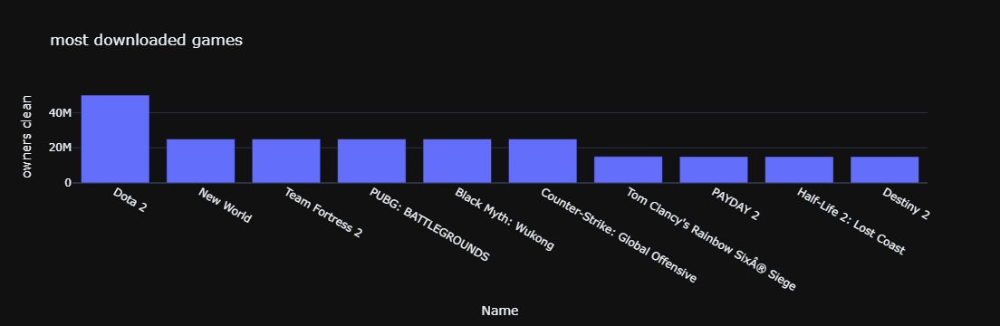

In [250]:
most_downloaded_games_graph = px.bar(most_downloaded_games, y='owners clean', x='Name', title='most downloaded games')
most_downloaded_games_graph.show()

### Most expensive games

In [257]:
df["Price"]

0        19.99
1         0.99
2         4.99
3         5.99
4         0.00
         ...  
97423     4.19
97424     8.99
97425     0.00
97426     4.99
97427     4.49
Name: Price, Length: 97265, dtype: float64

In [259]:
most_expensive_games = df.groupby("Name").agg({"Price":"sum"}).reset_index().sort_values("Price",ascending=False).head(10)

In [261]:
most_expensive_games

,Name,Price
80009,The Leverage Game,999.98
80010,The Leverage Game Business Edition,999.98
5479,Ascent Free-Roaming VR Experience,999.00
84532,True Love,500.00
2038,Aartform Curvy 3D 3.0,299.90
23879,EA SPORTS FCâ„¢ 24,279.96
37581,Houdini Indie,269.99
86226,VEGAS 19 Edit - Steam Edition,249.00
71812,Space Warrior,199.99
62557,ReRise,199.99


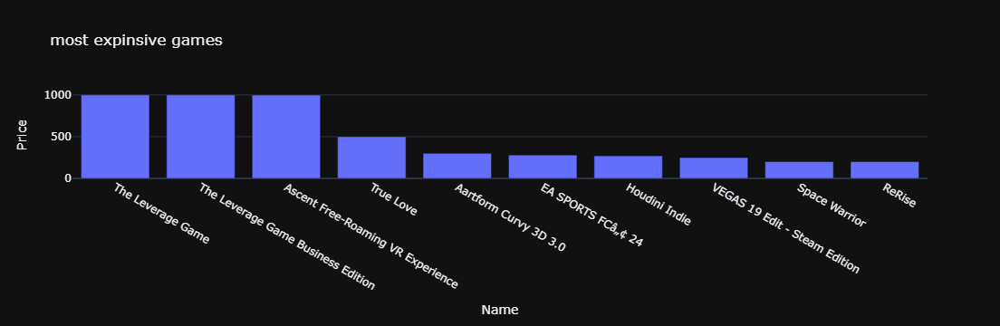

In [262]:
most_expensive_games_graph = px.bar(most_expensive_games, y='Price', x='Name', title='most expinsive games')
most_expensive_games_graph.show()

### Most downloaded games and their prices


In [265]:
most_downloaded_games_price = df.groupby(["Name","Price"]).agg({"owners clean":"sum"}).reset_index().sort_values("owners clean",ascending=False).head(10)

In [266]:
most_downloaded_games_price

,Name,Price,owners clean
22426,Dota 2,0.00,50000000.0
56889,PUBG: BATTLEGROUNDS,0.00,25000000.0
77688,Team Fortress 2,0.00,25000000.0
53540,New World,39.99,25000000.0
16515,Counter-Strike: Global Offensive,0.00,25000000.0
9149,Black Myth: Wukong,59.99,25000000.0
83749,Tom Clancy's Rainbow SixÂ® Siege,19.99,15040000.0
56606,PAYDAY 2,9.99,15000000.0
89095,Warframe,0.00,15000000.0
57650,Path of Exile,0.00,15000000.0


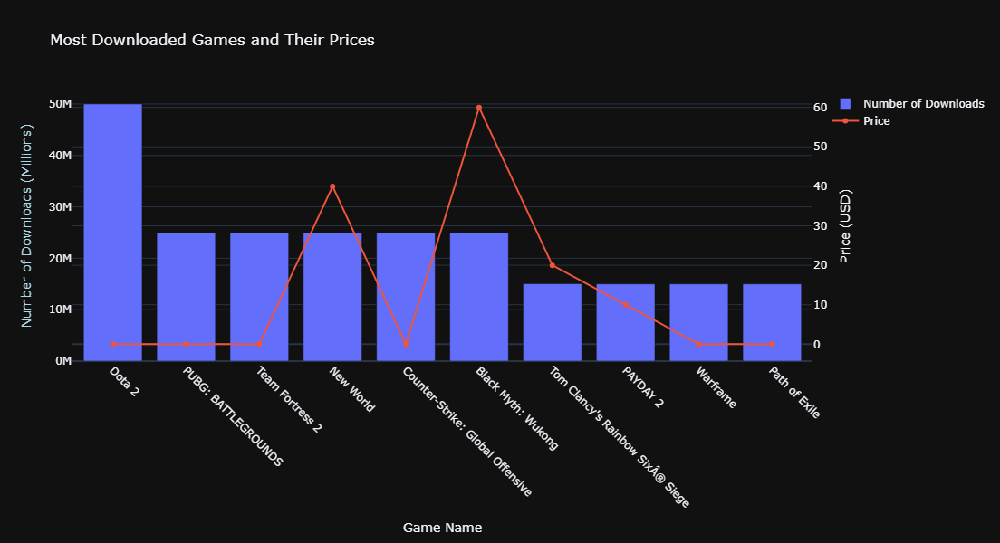

In [267]:
import plotly.graph_objects as go
fig = go.Figure()

fig.add_trace(go.Bar(
    x=most_downloaded_games_price['Name'],
    y=most_downloaded_games_price['owners clean'],
    name='Number of Downloads',
    yaxis='y1'
))

fig.add_trace(go.Scatter(
    x=most_downloaded_games_price['Name'],
    y=most_downloaded_games_price['Price'],
    name='Price',
    mode='lines+markers',
    yaxis='y2'
))

fig.update_layout(
    title='Most Downloaded Games and Their Prices',
    xaxis_title='Game Name',
    yaxis_title='Number of Downloads (Millions)',
    yaxis=dict(
        title='Number of Downloads (Millions)',
        titlefont=dict(color='lightblue'),
        tickformat='.0f',
        tickvals=[0, 10000000, 20000000, 30000000, 40000000, 50000000],
        ticktext=['0M', '10M', '20M', '30M', '40M', '50M']
    ),
    yaxis2=dict(
        title='Price (USD)',
        overlaying='y',
        side='right'
    ),
    xaxis=dict(tickangle=45),
    template='plotly_dark',
    height=600  
)
fig.show()

### Prices distribution

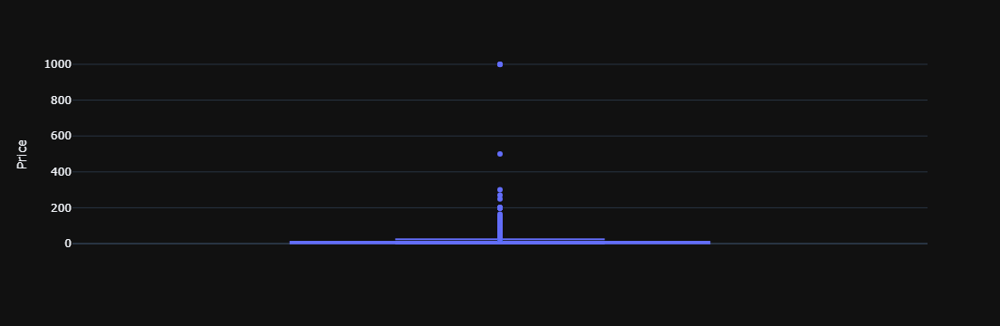

In [271]:
Prices_distribution_graph = px.box(df, y="Price")
Prices_distribution_graph

In [272]:
# Adding a 'Free or Paid' column to estimate the number of free and paid games in the store
def free_or_paid(x):
    if x == 0:
        return "Free"
    else:
        return "paid"

In [274]:
for index, row in df.iterrows(): 
     df.at[index, 'Free or paid'] = free_or_paid(df.at[index, 'Price'])

In [278]:
df.head(2)

,AppID,Name,Release date,Estimated owners,Peak CCU,Required age,Price,Discount,DLC count,About the game,...,Developers,Publishers,Categories,Genres,Tags,Screenshots,Movies,OS,owners clean,Free or paid
0,20200.0,Galactic Bowling,2008-10-21,0 - 20000,0.0,0.0,19.99,0.0,0.0,Galactic Bowling is an exaggerated and stylize...,...,Perpetual FX Creative,Perpetual FX Creative,"Single-player,Multi-player,Steam Achievements,...","Casual,Indie,Sports","Indie,Casual,Sports,Bowling",https://cdn.akamai.steamstatic.com/steam/apps/...,http://cdn.akamai.steamstatic.com/steam/apps/2...,Windows,10000.0,paid
1,655370.0,Train Bandit,2017-10-12,0 - 20000,0.0,0.0,0.99,0.0,0.0,THE LAW!! Looks to be a showdown atop a train....,...,Rusty Moyher,Wild Rooster,"Single-player,Steam Achievements,Full controll...","Action,Indie","Indie,Action,Pixel Graphics,2D,Retro,Arcade,Sc...",https://cdn.akamai.steamstatic.com/steam/apps/...,http://cdn.akamai.steamstatic.com/steam/apps/2...,"Windows, Mac",10000.0,paid


In [279]:
paid_and_free_count = df.groupby("Free or paid").agg({
    "Name":"count"
}).reset_index()
paid_and_free_count

,Free or paid,Name
0,Free,19666
1,paid,77599


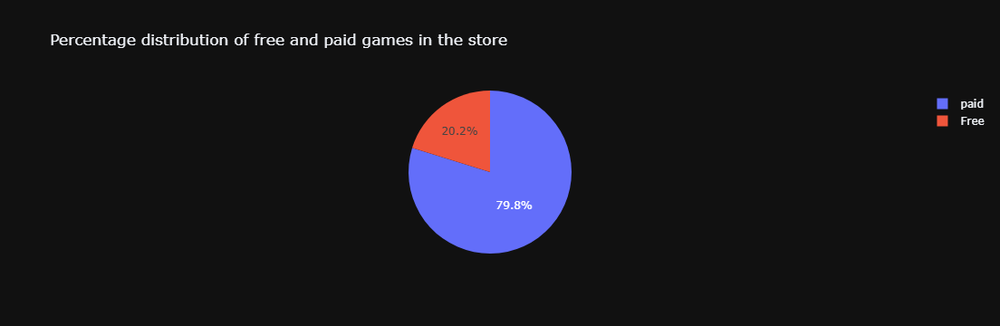

In [280]:
paid_and_free_count_graph = px.pie(paid_and_free_count, values='Name', names='Free or paid',
                                   title='Percentage distribution of free and paid games in the store')
paid_and_free_count_graph.show()

### Average downloads for free and paid games

In [282]:
paid_and_free_downloads = df.groupby("Free or paid").agg({"owners clean":"mean"}).reset_index()
paid_and_free_downloads

,Free or paid,owners clean
0,Free,43341.299705
1,paid,29724.545419


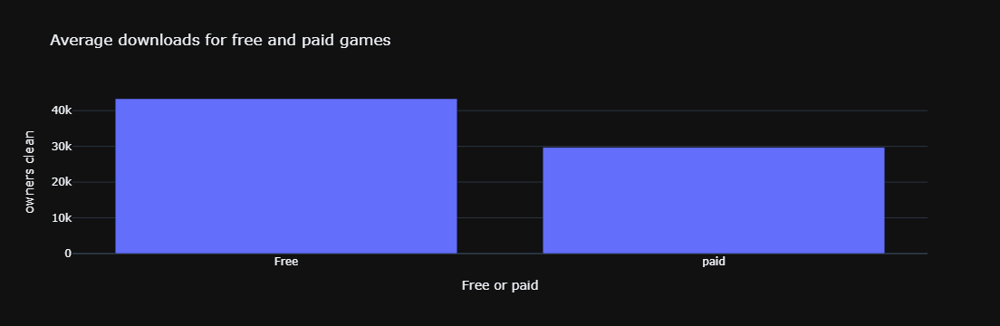

In [288]:
paid_and_free_downloads_graph = px.bar(paid_and_free_downloads, y='owners clean', x='Free or paid', title='Average downloads for free and paid games')
paid_and_free_downloads_graph.show()

In [289]:
df.columns

Index(['AppID', 'Name', 'Release date', 'Estimated owners', 'Peak CCU',
       'Required age', 'Price', 'Discount', 'DLC count', 'About the game',
       'Supported languages', 'Full audio languages', 'Header image',
       'Support email', 'Windows', 'Mac', 'Linux', 'Metacritic score',
       'User score', 'Positive', 'Negative', 'Achievements', 'Recommendations',
       'Average playtime forever', 'Average playtime two weeks',
       'Median playtime forever', 'Median playtime two weeks', 'Developers',
       'Publishers', 'Categories', 'Genres', 'Tags', 'Screenshots', 'Movies',
       'OS', 'owners clean', 'Free or paid'],
      dtype='object')

### Most Supported languages 

In [293]:
df["Supported languages"]

0                                              ['English']
1        ['English', 'French', 'Italian', 'German', 'Sp...
2                       ['English', 'Portuguese - Brazil']
3        ['English', 'French', 'Italian', 'German', 'Sp...
4                           ['English', 'Spanish - Spain']
                               ...                        
97423                               ['English', 'Russian']
97424    ['English', 'French', 'Italian', 'German', 'Sp...
97425                                          ['English']
97426                                          ['English']
97427                                          ['English']
Name: Supported languages, Length: 97265, dtype: object

In [294]:
language_count = {}
for language in df['Supported languages'].to_list():
    language = language.strip()
    language_sub = language.split(',')
    for key in language_sub:
        key = key.strip()
        key = key.replace("'", "")
        key = key.replace("[", "")
        key = key.replace("]", "")
        key = key.replace("&amp;lt;strong&amp;gt;&amp;lt;/strong&amp;gt;", "")
        key = key.replace("b/b", "")
        key = key.replace("/b", "")
        key = key.replace(" \\r\\n\\r\\nb/b ", "")
        key = key.replace("/b", "")
        key = key.replace("\\r\\nb/b", "")
        key = key.replace("\\r\\n", "")
        key = key.replace("#", "")
        key = key.replace("\r\\n\\r\\n", "")
        key = key.replace("Russian\\r\\nEnglish\\r\\nSpanish - Spain\\r\\nFrench\\r\\nJapanese\\r\\nCzech", "")
        key = key.replace("\r\\n", "")
        key = key.replace(" &amp;lt;br /&amp;gt;&amp;lt;br /&amp;gt; ", "")
        key = key.replace("RussianEnglishSpanish - SpainFrenchJapaneseCzech", "")
        language_count[key] = language_count.get(key, 0) + 1

In [296]:
language_count

{'English': 88121,
 'French': 20590,
 'Italian': 14319,
 'German': 21171,
 'Spanish - Spain': 19127,
 'Japanese': 18507,
 'Portuguese - Brazil': 11182,
 'Russian': 19753,
 'Simplified Chinese': 22891,
 'Traditional Chinese': 11450,
 'Korean': 11913,
 'Portuguese': 4173,
 'Danish': 3350,
 'Polish': 8762,
 'Turkish': 6556,
 'Czech': 4118,
 'Hungarian': 3517,
 'Dutch': 5250,
 'Ukrainian': 3950,
 'Spanish - Latin America': 5567,
 'Arabic': 3535,
 'Norwegian': 3275,
 'Romanian': 2976,
 'Swedish': 3852,
 'Thai': 3546,
 'Vietnamese': 2825,
 '': 4829,
 'Finnish': 3237,
 'Bulgarian': 2737,
 'Greek': 2960,
 'German;': 2,
 'lang_franÃ§ais': 1,
 'Traditional Chinese (text only)': 1,
 'Japanese  ': 1,
 'Italian  ': 1,
 'English (full audio)': 3,
 ' Korean': 1,
 'Slovakian': 2,
 'EnglishRussianSpanish - SpainJapaneseCzech': 1,
 'Japanese (all with full audio support)': 1,
 'English Dutch  English': 1,
 'Portuguese - Portugal': 3027,
 'Afrikaans': 722,
 'Amharic': 705,
 'Albanian': 724,
 'Assamese': 

In [297]:
language_count = pd.DataFrame.from_dict(language_count, orient='index').reset_index()

In [298]:
language_count.columns = ['language', 'Frequency']
language_count = language_count.sort_values('Frequency', ascending = False).head(10)

In [303]:
language_count

,language,Frequency
0,English,88121
8,Simplified Chinese,22891
3,German,21171
1,French,20590
7,Russian,19753
4,Spanish - Spain,19127
5,Japanese,18507
2,Italian,14319
10,Korean,11913
9,Traditional Chinese,11450


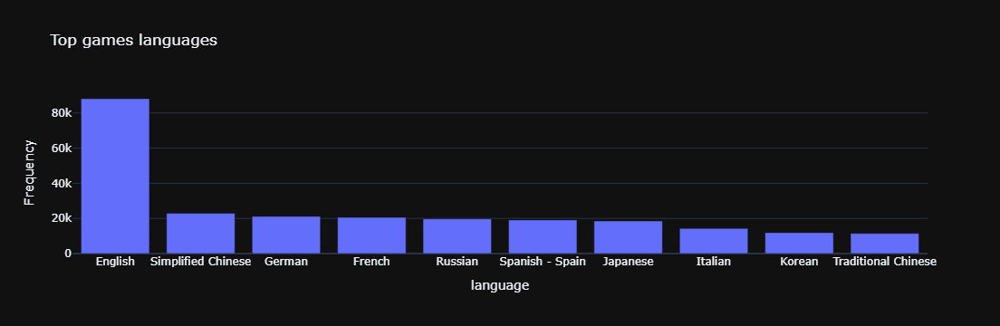

In [304]:
language_count_graph = px.bar(language_count, y='Frequency', x='language', title='Top games languages')
language_count_graph.show()

### Average downloads for games with support vs. games without support

In [308]:
df["Support email"].unique()

array(['no Support email available', 'support@rustymoyher.com',
       'ramoncampiaof31@gmail.com', ..., 'Rated.devs@gmail.com',
       'spellsweaver@gmail.com', 'supp.gettothegate@gmail.com'],
      dtype=object)

In [310]:
for index, row in df.iterrows():
    if  df.at[index, 'Support email'] == "no Support email available":
        df.at[index, 'Game have support'] = False
    else:
        df.at[index, 'Game have support'] = True

In [311]:
downloads_for_supported_games = df.groupby("Game have support").agg({
    "owners clean":"mean"
}).reset_index()
downloads_for_supported_games

,Game have support,owners clean
0,False,114776.012850
1,True,21761.407871


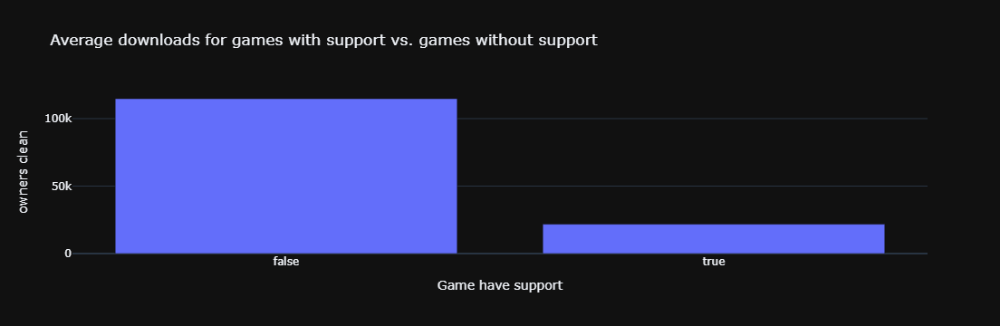

In [312]:
downloads_for_supported_games_graph = px.bar(downloads_for_supported_games, y='owners clean', x='Game have support', title='Average downloads for games with support vs. games without support')
downloads_for_supported_games_graph.show()

In [313]:
df.columns

Index(['AppID', 'Name', 'Release date', 'Estimated owners', 'Peak CCU',
       'Required age', 'Price', 'Discount', 'DLC count', 'About the game',
       'Supported languages', 'Full audio languages', 'Header image',
       'Support email', 'Windows', 'Mac', 'Linux', 'Metacritic score',
       'User score', 'Positive', 'Negative', 'Achievements', 'Recommendations',
       'Average playtime forever', 'Average playtime two weeks',
       'Median playtime forever', 'Median playtime two weeks', 'Developers',
       'Publishers', 'Categories', 'Genres', 'Tags', 'Screenshots', 'Movies',
       'OS', 'owners clean', 'Free or paid', 'Game have support'],
      dtype='object')

### Most popular operating systems for games

In [315]:
df["Windows"].sum()

97239

In [321]:
df["Mac"].sum()

45712

In [322]:
df["Linux"].sum()

41256

In [325]:
df["OS"].unique()

array(['Windows', 'Windows, Mac', 'Windows, Mac, Linux', 'Windows, Linux',
       'Mac', 'Linux'], dtype=object)

In [327]:
# Games that are compatible with multiple operating systems
average_downloads_for_different_os = df.groupby("OS").agg({"owners clean":"mean"}).reset_index()
average_downloads_for_different_os

,OS,owners clean
0,Linux,11666.666667
1,Mac,10454.545455
2,Windows,33911.260254
3,"Windows, Linux",46085.832472
4,"Windows, Mac",50236.263736
5,"Windows, Mac, Linux",27136.244564


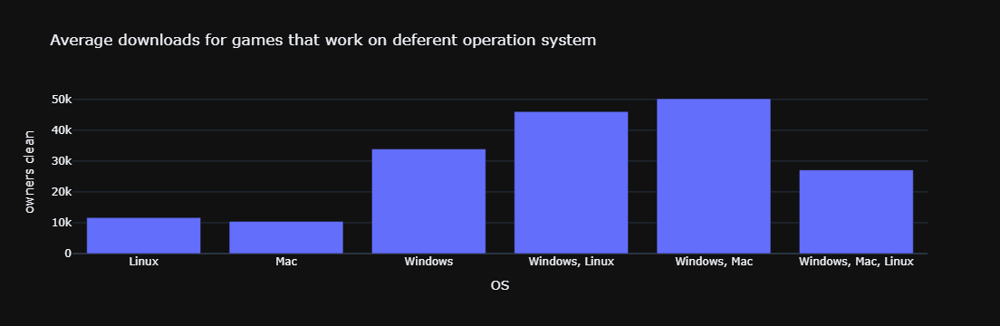

In [328]:
average_downloads_for_different_os_graph = px.bar(average_downloads_for_different_os, y='owners clean', x='OS', title='Average downloads for games that work on deferent operation system')
average_downloads_for_different_os_graph.show()

### Top games that have positive ratings and negative ratings 

In [332]:
df["Positive"].max()

5764420

In [334]:
top_positive_rated_games = df.groupby("Name").agg({"Positive":"sum"}).reset_index().sort_values("Positive",ascending = False).head(10)
top_positive_rated_games

,Name,Positive
16387,Counter-Strike: Global Offensive,5764420
83131,Tom Clancy's Rainbow SixÂ® Siege,2179536
22261,Dota 2,1477153
33122,Grand Theft Auto V,1171197
56491,PUBG: BATTLEGROUNDS,1154655
77500,Terraria,964983
77141,Team Fortress 2,823693
31507,Garry's Mod,822326
65567,Rust,703687
9082,Black Myth: Wukong,663109


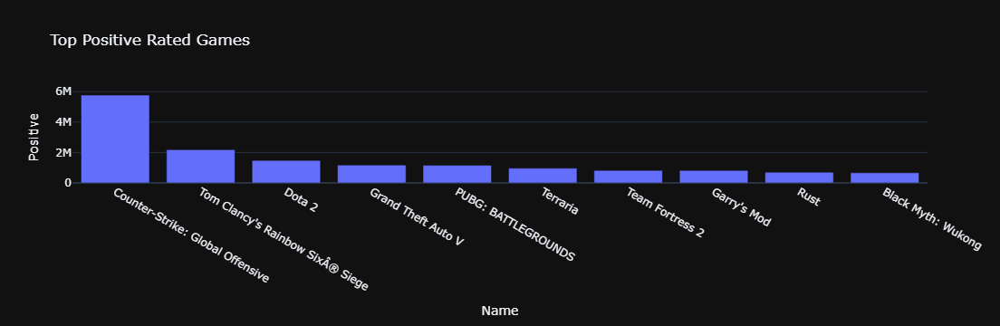

In [336]:
top_positive_rated_games_graph = px.bar(top_positive_rated_games, y='Positive', x='Name', title='Top Positive Rated Games')
top_positive_rated_games_graph.show()

In [338]:
top_negative_rated_games = df.groupby("Name").agg({"Negative":"sum"}).reset_index().sort_values("Negative",ascending = False).head(10)
top_negative_rated_games

,Name,Negative
56491,PUBG: BATTLEGROUNDS,895978
16387,Counter-Strike: Global Offensive,766677
83131,Tom Clancy's Rainbow SixÂ® Siege,395207
22261,Dota 2,300437
33122,Grand Theft Auto V,210154
17970,Cyberpunk 2077,129925
19581,Dead by Daylight,112924
65567,Rust,108223
7907,Battlefieldâ„¢ 2042,106038
96042,é¬¼è°·å…«è’ Tale of Immortal,103661


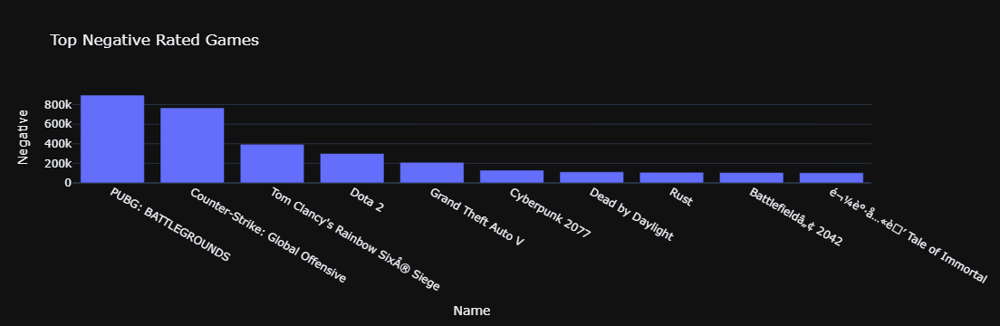

In [340]:
top_negative_rated_games_graph = px.bar(top_negative_rated_games, y='Negative', x='Name', title='Top Negative Rated Games')
top_negative_rated_games_graph.show()

### Most Downloaded Games with Their Positive and Negative Ratings

In [343]:
top_downloaded_games_with_ratings = df.groupby("Name").agg({
    "owners clean":"sum",
    "Negative":"sum",
    "Positive":"sum"
}).reset_index().sort_values("owners clean",ascending = False).head(10)
top_downloaded_games_with_ratings

,Name,owners clean,Negative,Positive
22261,Dota 2,50000000.0,300437,1477153
53166,New World,25000000.0,73900,154914
77141,Team Fortress 2,25000000.0,56683,823693
56491,PUBG: BATTLEGROUNDS,25000000.0,895978,1154655
9082,Black Myth: Wukong,25000000.0,28700,663109
16387,Counter-Strike: Global Offensive,25000000.0,766677,5764420
83131,Tom Clancy's Rainbow SixÂ® Siege,15040000.0,395207,2179536
56208,PAYDAY 2,15000000.0,62574,520826
34497,Half-Life 2: Lost Coast,15000000.0,1261,9306
20761,Destiny 2,15000000.0,77006,403109


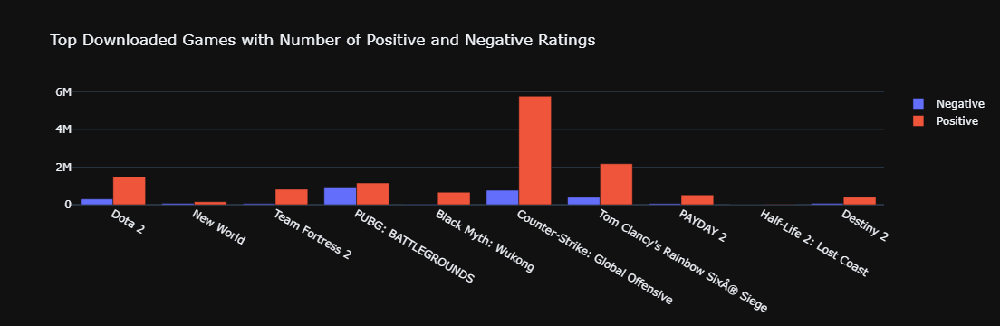

In [345]:
top_downloaded_games_with_ratings_graph = go.Figure(data=[
    go.Bar(name='Negative', x=top_downloaded_games_with_ratings["Name"], y=top_downloaded_games_with_ratings["Negative"]),
    go.Bar(name='Positive', x=top_downloaded_games_with_ratings["Name"], y=top_downloaded_games_with_ratings["Positive"])
])
top_downloaded_games_with_ratings_graph.update_layout(
    barmode='group',
    title_text='Top Downloaded Games with Number of Positive and Negative Ratings'
)
top_downloaded_games_with_ratings_graph.show()

### Relationship between the number of downloads and the ratings of games

In [348]:
df_sorted_downloads = df.sort_values("owners clean",ascending=False)

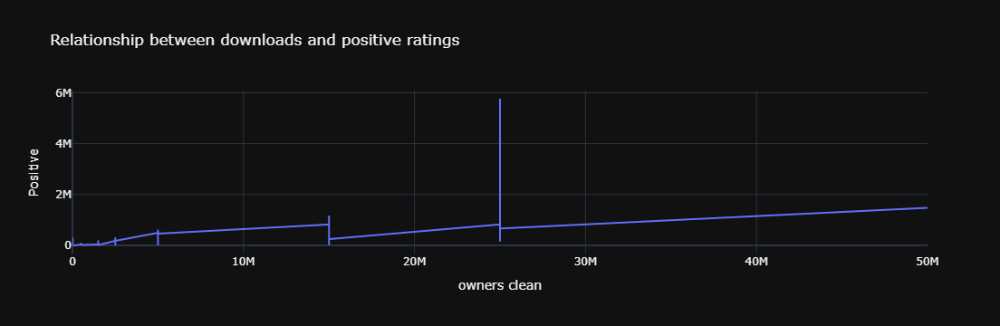

In [350]:
downloads_vs_positive_ratings = px.line(df_sorted_downloads, x="owners clean", y="Positive", title='Relationship between downloads and positive ratings')
downloads_vs_positive_ratings.show()

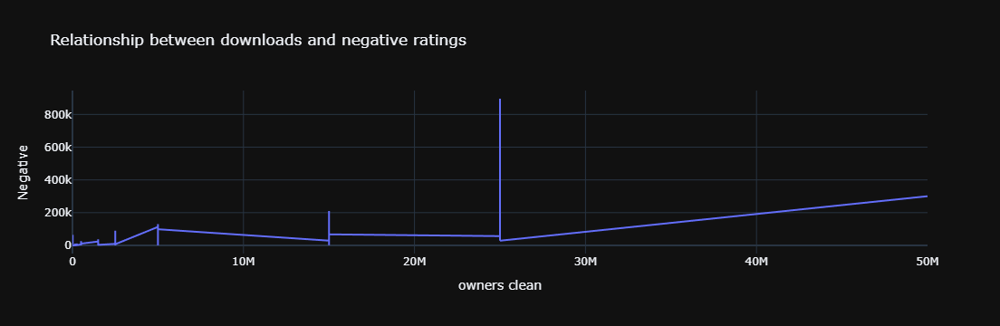

In [352]:
downloads_vs_negative_ratings = px.line(df_sorted_downloads, x="owners clean", y="Negative", title='Relationship between downloads and negative ratings')
downloads_vs_negative_ratings.show()

## Relationship Between Price and Ratings

In [355]:
df_sorted_price = df.sort_values("Price",ascending=False)

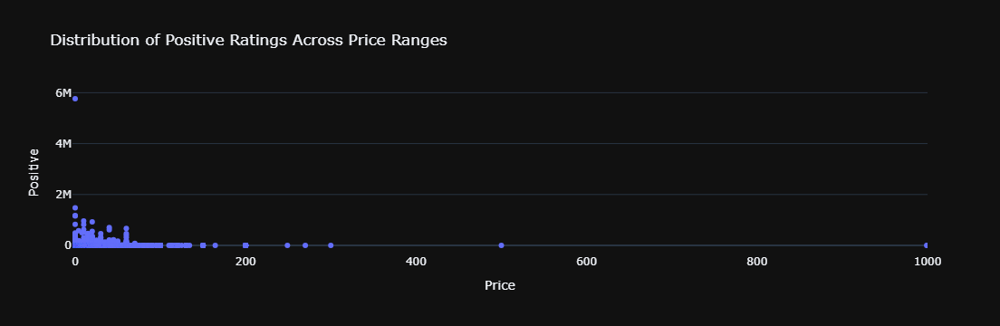

In [356]:
price_vs_positive_ratings_box = px.box(df_sorted_price, x="Price", y="Positive", 
                                       title='Distribution of Positive Ratings Across Price Ranges',
                                       points="all",  
                                       hover_name="Name")
price_vs_positive_ratings_box.show()

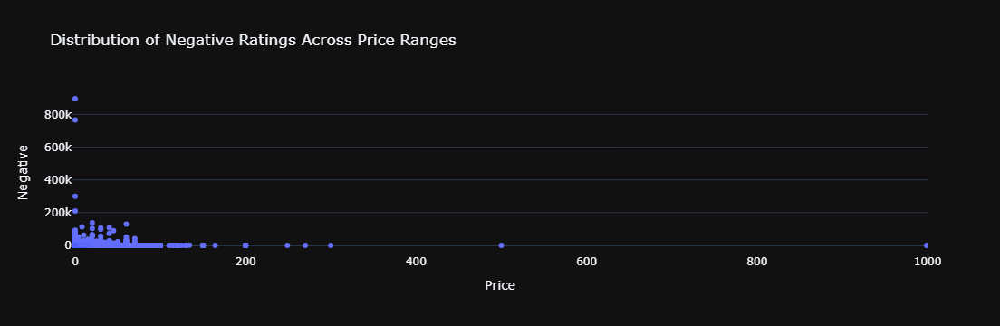

In [358]:
price_vs_negative_ratings_box = px.box(df_sorted_price, x="Price", y="Negative", 
                                       title='Distribution of Negative Ratings Across Price Ranges',
                                       points="all",  
                                       hover_name="Name")
price_vs_negative_ratings_box.show()

In [360]:
df.columns

Index(['AppID', 'Name', 'Release date', 'Estimated owners', 'Peak CCU',
       'Required age', 'Price', 'Discount', 'DLC count', 'About the game',
       'Supported languages', 'Full audio languages', 'Header image',
       'Support email', 'Windows', 'Mac', 'Linux', 'Metacritic score',
       'User score', 'Positive', 'Negative', 'Achievements', 'Recommendations',
       'Average playtime forever', 'Average playtime two weeks',
       'Median playtime forever', 'Median playtime two weeks', 'Developers',
       'Publishers', 'Categories', 'Genres', 'Tags', 'Screenshots', 'Movies',
       'OS', 'owners clean', 'Free or paid', 'Game have support'],
      dtype='object')

### Top Developers 

In [362]:
developers_most_downloads = df.groupby("Developers").agg({"owners clean":"sum"}).reset_index().sort_values("owners clean",ascending = False).head(10)
developers_most_downloads

,Developers,owners clean
48507,Valve,174370000.0
15180,Facepunch Studios,30050000.0
17447,Game Science,25500000.0
24017,"KRAFTON, Inc.",25275000.0
2491,Amazon Games,25000000.0
48509,"Valve,Hidden Path Entertainment",25000000.0
47778,Ubisoft Montreal,22395000.0
7306,"CAPCOM Co., Ltd.",19210000.0
5352,Bethesda Game Studios,17250000.0
38055,Respawn Entertainment,17075000.0


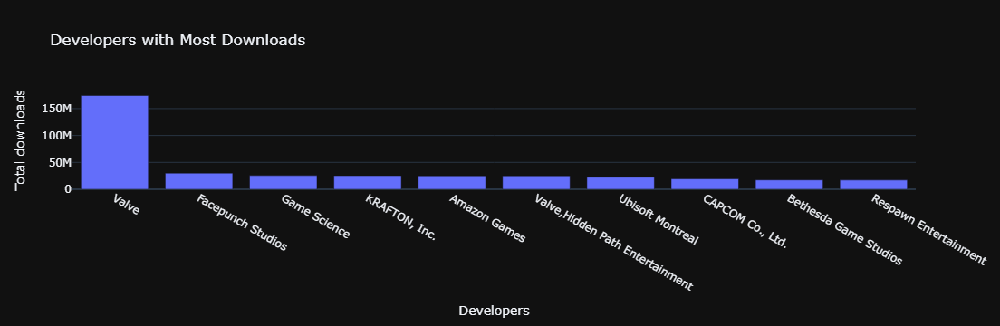

In [363]:
developers_most_downloads_graph = px.bar(developers_most_downloads, y='owners clean', x='Developers', title='Developers with Most Downloads',
  labels={ "owners clean": "Total downloads",})
developers_most_downloads_graph.show()

In [364]:
# Developers with the Highest Downloads, Including Positive and Negative Ratings
top_developers_downloads_with_positive_and_negative= df.groupby("Developers").agg({
    "owners clean":"sum",
    "Positive":"sum",
    "Negative":"sum"
}).reset_index().sort_values("owners clean",ascending = False).head(10)
top_developers_downloads_with_positive_and_negative

,Developers,owners clean,Positive,Negative
48507,Valve,174370000.0,4485026,450698
15180,Facepunch Studios,30050000.0,1527225,137407
17447,Game Science,25500000.0,668350,30105
24017,"KRAFTON, Inc.",25275000.0,1157817,897352
2491,Amazon Games,25000000.0,154914,73900
48509,"Valve,Hidden Path Entertainment",25000000.0,5764420,766677
47778,Ubisoft Montreal,22395000.0,2386620,432780
7306,"CAPCOM Co., Ltd.",19210000.0,861749,125303
5352,Bethesda Game Studios,17250000.0,1011497,174578
38055,Respawn Entertainment,17075000.0,620908,84736


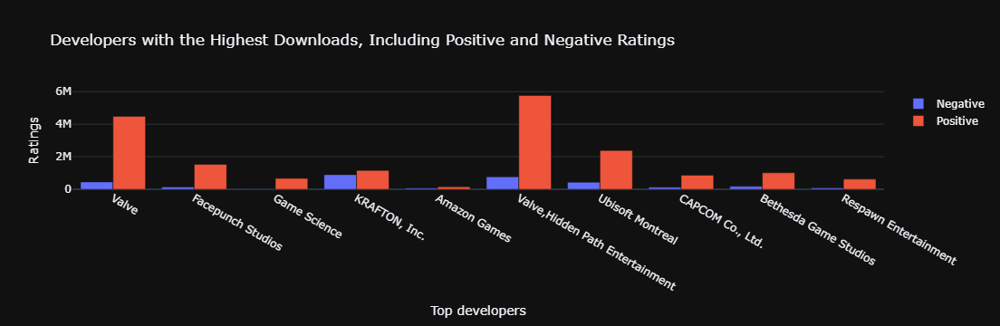

In [370]:
top_downloaded_games_with_rating_graph = go.Figure(data=[
    go.Bar(name='Negative', x=top_developers_downloads_with_positive_and_negative["Developers"],
           y=top_developers_downloads_with_positive_and_negative["Negative"]),
    go.Bar(name='Positive', x=top_developers_downloads_with_positive_and_negative["Developers"], 
           y=top_developers_downloads_with_positive_and_negative["Positive"])
])
# Change the bar mode
top_downloaded_games_with_rating_graph.update_layout(barmode='group',
    title_text='Developers with the Highest Downloads, Including Positive and Negative Ratings',
    xaxis_title="Top developers",
    yaxis_title="Ratings")
top_downloaded_games_with_rating_graph.show()

In [371]:
# Most positive-rated developers
top_developers_total_positive_ratings = df.groupby("Developers").agg({"Positive":"sum"}).reset_index().sort_values("Positive",ascending = False).head(10)
top_developers_total_positive_ratings

,Developers,Positive
48509,"Valve,Hidden Path Entertainment",5764420
48507,Valve,4485026
47778,Ubisoft Montreal,2386620
15180,Facepunch Studios,1527225
38624,Rockstar North,1173846
7354,CD PROJEKT RED,1169827
24017,"KRAFTON, Inc.",1157817
5352,Bethesda Game Studios,1011497
37430,Re-Logic,964983
7306,"CAPCOM Co., Ltd.",861749


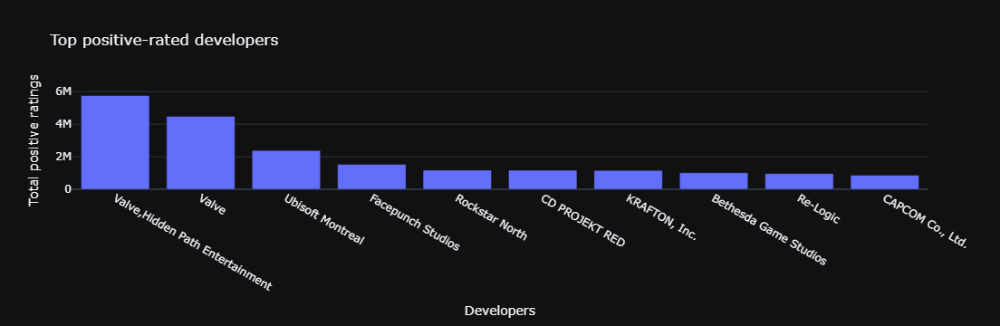

In [372]:
top_developers_total_positive_ratings_graph = px.bar(top_developers_total_positive_ratings, y='Positive', x='Developers',
                                                     title='Top positive-rated developers',labels={ "Positive": "Total positive ratings",})
top_developers_total_positive_ratings_graph.show()

In [374]:
# Most negative-rated developers
top_devs_neg_ratings = df.groupby("Developers").agg({"Negative":"sum"}).reset_index().sort_values("Negative",ascending = False).head(10)
top_devs_neg_ratings

,Developers,Negative
24017,"KRAFTON, Inc.",897352
48509,"Valve,Hidden Path Entertainment",766677
48507,Valve,450698
47778,Ubisoft Montreal,432780
38624,Rockstar North,211162
7354,CD PROJEKT RED,177171
10595,DICE,176590
5352,Bethesda Game Studios,174578
15180,Facepunch Studios,137407
6352,Bohemia Interactive,128096


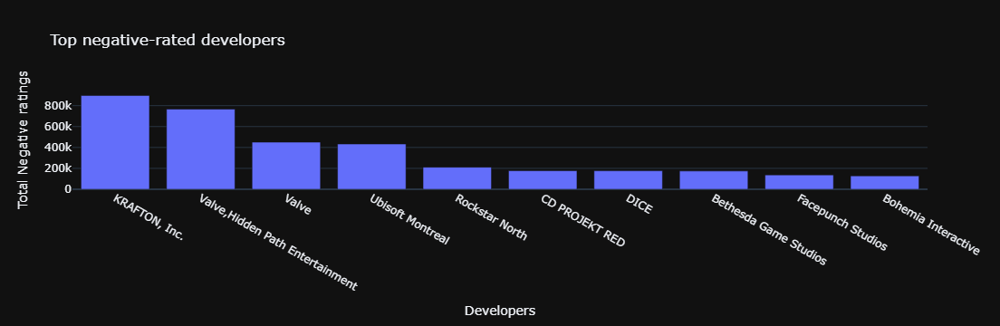

In [375]:
top_devs_neg_ratings_graph = px.bar(top_devs_neg_ratings, y='Negative', x='Developers', title= 'Top negative-rated developers',
  labels={ "Negative": "Total Negative ratings",})
top_devs_neg_ratings_graph.show()

### Top Publishers

In [378]:
top_publishers_total_downloads = df.groupby("Publishers").agg({"owners clean":"sum"}).reset_index().sort_values("owners clean",
                                                                                                                ascending = False).head(10)
top_publishers_total_downloads

,Publishers,owners clean
42561,Valve,222020000.0
41896,Ubisoft,66395000.0
12050,Electronic Arts,57750000.0
4678,Bethesda Softworks,42730000.0
44559,Xbox Game Studios,41120000.0
2182,Amazon Games,40000000.0
259,2K,32845000.0
34491,SEGA,32475000.0
33955,Rockstar Games,30365000.0
37511,Square Enix,28015000.0


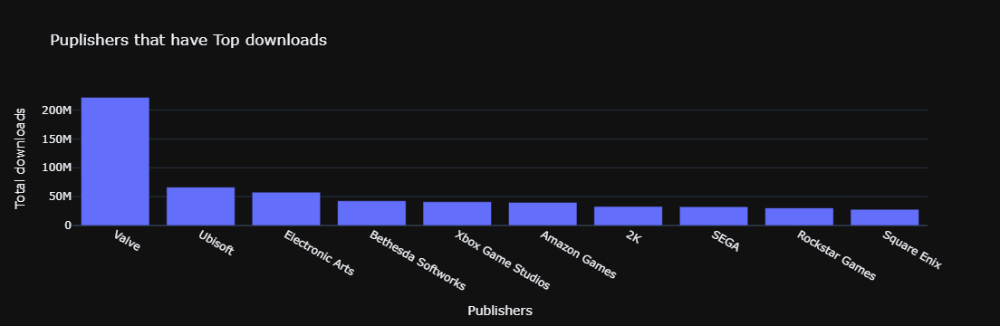

In [379]:
top_publishers_total_downloads_graph = px.bar(top_publishers_total_downloads, y='owners clean', x='Publishers',
                                              title='Puplishers that have Top downloads',labels={ "owners clean": "Total downloads",})
top_publishers_total_downloads_graph.show()

In [380]:
# Top Publishers by Downloads with Positive and Negative Ratings
top_Publishers_downloads_with_positive_and_negative= df.groupby("Publishers").agg({
    "owners clean":"sum",
    "Positive":"sum",
    "Negative":"sum"
}).reset_index().sort_values("owners clean",ascending = False).head(10)
top_Publishers_downloads_with_positive_and_negative

,Publishers,owners clean,Positive,Negative
42561,Valve,222020000.0,11097327,1248173
41896,Ubisoft,66395000.0,3630187,727119
12050,Electronic Arts,57750000.0,1863575,444783
4678,Bethesda Softworks,42730000.0,2057753,315314
44559,Xbox Game Studios,41120000.0,1445136,189528
2182,Amazon Games,40000000.0,279222,117966
259,2K,32845000.0,628702,195795
34491,SEGA,32475000.0,809011,120151
33955,Rockstar Games,30365000.0,1764218,304783
37511,Square Enix,28015000.0,774824,161570


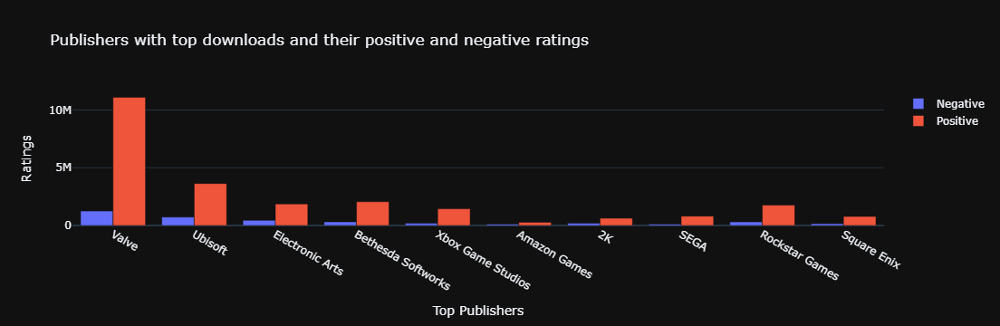

In [381]:
top_downloaded_games_with_rating_graph = go.Figure(data=[
    go.Bar(name='Negative', x=top_Publishers_downloads_with_positive_and_negative["Publishers"],
           y=top_Publishers_downloads_with_positive_and_negative["Negative"]),
    go.Bar(name='Positive', x=top_Publishers_downloads_with_positive_and_negative["Publishers"],
           y=top_Publishers_downloads_with_positive_and_negative["Positive"])
])
# Change the bar mode
top_downloaded_games_with_rating_graph.update_layout(barmode='group',
    title_text=' Publishers with top downloads and their positive and negative ratings',
    xaxis_title="Top Publishers",
    yaxis_title="Ratings")
top_downloaded_games_with_rating_graph.show()

### Games Categories

In [390]:
df["Categories"].unique()

array(['Single-player,Multi-player,Steam Achievements,Partial Controller Support',
       'Single-player,Steam Achievements,Full controller support,Steam Leaderboards,Remote Play on Phone,Remote Play on Tablet,Remote Play on TV',
       'Single-player', ...,
       'Single-player,Multi-player,PvP,Online PvP,Steam Achievements,Steam Workshop,Steam Cloud,Family Sharing',
       'Multi-player,PvP,Online PvP,Co-op,Online Co-op,Steam Achievements,Steam Cloud,Family Sharing',
       'Single-player,Steam Achievements,Full controller support,Steam Cloud,Steam Leaderboards,Remote Play on Phone,Remote Play on TV,Family Sharing'],
      dtype=object)

In [391]:
df["Categories"][0]

'Single-player,Multi-player,Steam Achievements,Partial Controller Support'

In [392]:
def categories_clean(x):
    x = x.split(",")
    return x

In [393]:
categories_clean('Single-player,Multi-player,Steam Achievements,Partial Controller Support')

['Single-player',
 'Multi-player',
 'Steam Achievements',
 'Partial Controller Support']

In [394]:
categories_count = {}
for categories in df['Categories']:
    words = categories_clean(categories)
    for word in words:
        categories_count[word] = categories_count.get(word, 0) + 1

In [395]:
categories_count

{'Single-player': 86771,
 'Multi-player': 17150,
 'Steam Achievements': 41189,
 'Partial Controller Support': 11504,
 'Full controller support': 18310,
 'Steam Leaderboards': 7377,
 'Remote Play on Phone': 844,
 'Remote Play on Tablet': 1004,
 'Remote Play on TV': 2235,
 'MMO': 1436,
 'PvP': 10820,
 'Online PvP': 7738,
 'Co-op': 8730,
 'Online Co-op': 5119,
 'In-App Purchases': 2613,
 'Steam Cloud': 21107,
 'Steam Trading Cards': 9948,
 'Shared/Split Screen': 6168,
 'Cross-Platform Multiplayer': 2520,
 'Remote Play Together': 6605,
 'Stats': 3854,
 'Shared/Split Screen PvP': 4387,
 'no Category added': 1237,
 'Captions available': 1250,
 'Steam Workshop': 1971,
 'Includes level editor': 2083,
 'LAN PvP': 825,
 'LAN Co-op': 734,
 'Shared/Split Screen Co-op': 3463,
 'Playtest game not playable': 4561,
 'Steam Turn Notifications': 94,
 'VR Support': 251,
 'SteamVR Collectibles': 41,
 'Valve Anti-Cheat enabled': 124,
 'Includes Source SDK': 54,
 'Commentary available': 249,
 'Editor of a g

In [396]:
categories_count = pd.DataFrame.from_dict(categories_count, orient='index').reset_index()

In [397]:
categories_count.columns = ['category', 'Frequency']
categories_count = categories_count.sort_values('Frequency', ascending = False)
categories_count

,category,Frequency
0,Single-player,86771
2,Steam Achievements,41189
15,Steam Cloud,21107
4,Full controller support,18310
1,Multi-player,17150
3,Partial Controller Support,11504
10,PvP,10820
16,Steam Trading Cards,9948
12,Co-op,8730
11,Online PvP,7738


In [398]:
# Most common game categories in the store
categories_count.head(10)

,category,Frequency
0,Single-player,86771
2,Steam Achievements,41189
15,Steam Cloud,21107
4,Full controller support,18310
1,Multi-player,17150
3,Partial Controller Support,11504
10,PvP,10820
16,Steam Trading Cards,9948
12,Co-op,8730
11,Online PvP,7738


In [399]:
for index, row in categories_count.iterrows():
    if categories_count.at[index , "Frequency"] < 5943 :
        categories_count.at[index , "category"] = "others"

In [400]:
categories_count

,category,Frequency
0,Single-player,86771
2,Steam Achievements,41189
15,Steam Cloud,21107
4,Full controller support,18310
1,Multi-player,17150
3,Partial Controller Support,11504
10,PvP,10820
16,Steam Trading Cards,9948
12,Co-op,8730
11,Online PvP,7738


In [412]:
pie_chart_categories_count = categories_count.groupby("category").agg({"Frequency":"sum"}).reset_index()
pie_chart_categories_count

,category,Frequency
0,Co-op,8730
1,Family Sharing,7186
2,Full controller support,18310
3,Multi-player,17150
4,Online PvP,7738
5,Partial Controller Support,11504
6,PvP,10820
7,Remote Play Together,6605
8,Shared/Split Screen,6168
9,Single-player,86771


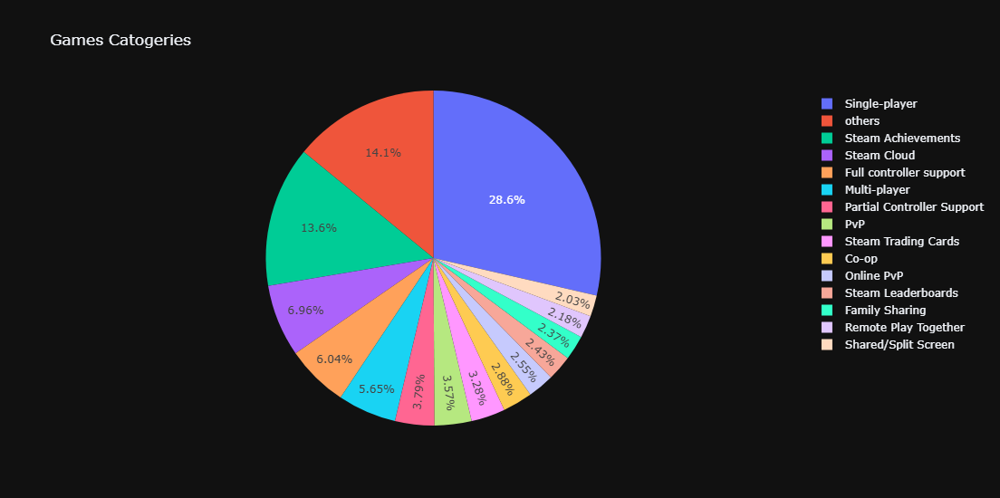

In [413]:
top_cattegories_graph = px.pie(pie_chart_categories_count, values='Frequency', names='category', title='Games Catogeries').update_layout( width=700,
                                                                                                                                         height=550 )
top_cattegories_graph.show()

### Top 3 Categories by Average Downloads

In [415]:
df_categories = df[["Name","owners clean","Price","Categories"]].copy()

In [416]:
df_categories

,Name,owners clean,Price,Categories
0,Galactic Bowling,10000.0,19.99,"Single-player,Multi-player,Steam Achievements,..."
1,Train Bandit,10000.0,0.99,"Single-player,Steam Achievements,Full controll..."
2,Jolt Project,10000.0,4.99,Single-player
3,Henosisâ„¢,10000.0,5.99,"Single-player,Full controller support"
4,Two Weeks in Painland,10000.0,0.00,"Single-player,Steam Achievements"
...,...,...,...,...
97423,Femdom Game World: Mom,10000.0,4.19,"Single-player,Family Sharing"
97424,Blocky Farm,0.0,8.99,"Single-player,Steam Achievements,Partial Contr..."
97425,Infiltrate & Extract,0.0,0.00,Single-player
97426,Escape The Garage,0.0,4.99,"Single-player,Steam Achievements,Family Sharing"


In [417]:
#creating 3 columns for top 3 Categories
for index, row in df_categories.iterrows():
    if "Single-player" in row["Categories"]:
        df_categories.at[index , "Single-player"] = True
for index, row in df_categories.iterrows():
    if "Steam Achievements" in row["Categories"]:
        df_categories.at[index ,"Steam Achievements"] = True
for index, row in df_categories.iterrows():
    if "Steam Cloud" in row["Categories"]:
        df_categories.at[index ,"Steam Cloud"] = True
        

In [418]:
df_categories

,Name,owners clean,Price,Categories,Single-player,Steam Achievements,Steam Cloud
0,Galactic Bowling,10000.0,19.99,"Single-player,Multi-player,Steam Achievements,...",True,True,NaN
1,Train Bandit,10000.0,0.99,"Single-player,Steam Achievements,Full controll...",True,True,NaN
2,Jolt Project,10000.0,4.99,Single-player,True,NaN,NaN
3,Henosisâ„¢,10000.0,5.99,"Single-player,Full controller support",True,NaN,NaN
4,Two Weeks in Painland,10000.0,0.00,"Single-player,Steam Achievements",True,True,NaN
...,...,...,...,...,...,...,...
97423,Femdom Game World: Mom,10000.0,4.19,"Single-player,Family Sharing",True,NaN,NaN
97424,Blocky Farm,0.0,8.99,"Single-player,Steam Achievements,Partial Contr...",True,True,True
97425,Infiltrate & Extract,0.0,0.00,Single-player,True,NaN,NaN
97426,Escape The Garage,0.0,4.99,"Single-player,Steam Achievements,Family Sharing",True,True,NaN


In [419]:
# Average downloads for Single-player category 
df_categories.groupby("Single-player").agg({
    "owners clean":"mean"
})

,owners clean
Single-player,
True,29781.263325


In [420]:
# Average downloads for Steam Achievements category 

df_categories.groupby("Steam Achievements").agg({
    "owners clean":"mean"
})

,owners clean
Steam Achievements,
True,47717.108937


In [429]:
# Average downloads for Steam Cloud category 

df_categories.groupby("Steam Cloud").agg({
    "owners clean":"mean"
})

,owners clean
Steam Cloud,
True,58545.269342


In [430]:
df.columns

Index(['AppID', 'Name', 'Release date', 'Estimated owners', 'Peak CCU',
       'Required age', 'Price', 'Discount', 'DLC count', 'About the game',
       'Supported languages', 'Full audio languages', 'Header image',
       'Support email', 'Windows', 'Mac', 'Linux', 'Metacritic score',
       'User score', 'Positive', 'Negative', 'Achievements', 'Recommendations',
       'Average playtime forever', 'Average playtime two weeks',
       'Median playtime forever', 'Median playtime two weeks', 'Developers',
       'Publishers', 'Categories', 'Genres', 'Tags', 'Screenshots', 'Movies',
       'OS', 'owners clean', 'Free or paid', 'Game have support'],
      dtype='object')

### Top Genres

In [434]:
df["Genres"].unique()

array(['Casual,Indie,Sports', 'Action,Indie',
       'Action,Adventure,Indie,Strategy', ...,
       'Casual,Indie,Racing,Free To Play',
       'Adventure,Free To Play,Early Access',
       'Casual,Massively Multiplayer,RPG,Simulation,Strategy,Free To Play'],
      dtype=object)

In [436]:
df["Genres"]

0                    Casual,Indie,Sports
1                           Action,Indie
2        Action,Adventure,Indie,Strategy
3                 Adventure,Casual,Indie
4                        Adventure,Indie
                      ...               
97423                             Casual
97424         Casual,Simulation,Strategy
97425              Strategy,Free To Play
97426             Adventure,Casual,Indie
97427                Action,Casual,Indie
Name: Genres, Length: 97265, dtype: object

In [438]:
def genres_clean(x):
    x = x.split(",")
    return x

In [440]:
genres_clean('Casual,Indie,Sports')

['Casual', 'Indie', 'Sports']

In [442]:
genres_count = {}
for genres in df['Genres']:
    words = genres_clean(genres)
    for word in words:
        genres_count[word] = genres_count.get(word, 0) + 1

In [444]:
genres_count

{'Casual': 39263,
 'Indie': 64418,
 'Sports': 4254,
 'Action': 37946,
 'Adventure': 35802,
 'Strategy': 17725,
 'Free to Play': 7891,
 'Massively Multiplayer': 2408,
 'RPG': 16613,
 'Simulation': 18567,
 'Early Access': 12058,
 'Racing': 3473,
 'Utilities': 920,
 'Playtest game not playable': 4641,
 'Sexual Content': 108,
 'Nudity': 120,
 'Violent': 527,
 'Gore': 311,
 'Design & Illustration': 535,
 'Education': 415,
 'Animation & Modeling': 440,
 'Game Development': 258,
 'no Genres added': 124,
 'Web Publishing': 115,
 'Software Training': 216,
 'Photo Editing': 148,
 'Audio Production': 218,
 'Video Production': 316,
 'Accounting': 26,
 'Beta game not playable': 32,
 'Editor of a game not playable': 6,
 'Alpha game not playable': 5,
 'test game not playable': 16,
 'Server of a game not playable': 11,
 'Software Development Kit of the game not playable': 2,
 'Movie': 2,
 'Documentary': 1,
 'Episodic': 1,
 'Short': 2,
 'Tutorial': 1,
 '360 Video': 1,
 'Demo game not playable': 1,
 'Fr

In [446]:
genres_count = pd.DataFrame.from_dict(genres_count, orient='index').reset_index()
genres_count.columns = ['Genres', 'Frequency']
genres_count = genres_count.sort_values('Frequency', ascending = False)
genres_count

,Genres,Frequency
1,Indie,64418
0,Casual,39263
3,Action,37946
4,Adventure,35802
9,Simulation,18567
5,Strategy,17725
8,RPG,16613
10,Early Access,12058
6,Free to Play,7891
13,Playtest game not playable,4641


In [447]:
# Top 10 Game Genres in the Store
genres_count.head(10)

,Genres,Frequency
1,Indie,64418
0,Casual,39263
3,Action,37946
4,Adventure,35802
9,Simulation,18567
5,Strategy,17725
8,RPG,16613
10,Early Access,12058
6,Free to Play,7891
13,Playtest game not playable,4641


In [448]:
for index, row in genres_count.iterrows():
    if genres_count.at[index , "Frequency"] < 2964 :
        genres_count.at[index , "Genres"] = "others"

In [450]:
genres_count

,Genres,Frequency
1,Indie,64418
0,Casual,39263
3,Action,37946
4,Adventure,35802
9,Simulation,18567
5,Strategy,17725
8,RPG,16613
10,Early Access,12058
6,Free to Play,7891
13,Playtest game not playable,4641


In [451]:
pie_chart_genres_count = genres_count.groupby("Genres").agg({
    "Frequency":"sum"
}).reset_index()
pie_chart_genres_count

,Genres,Frequency
0,Action,37946
1,Adventure,35802
2,Casual,39263
3,Early Access,12058
4,Free to Play,7891
5,Indie,64418
6,Playtest game not playable,4641
7,RPG,16613
8,Racing,3473
9,Simulation,18567


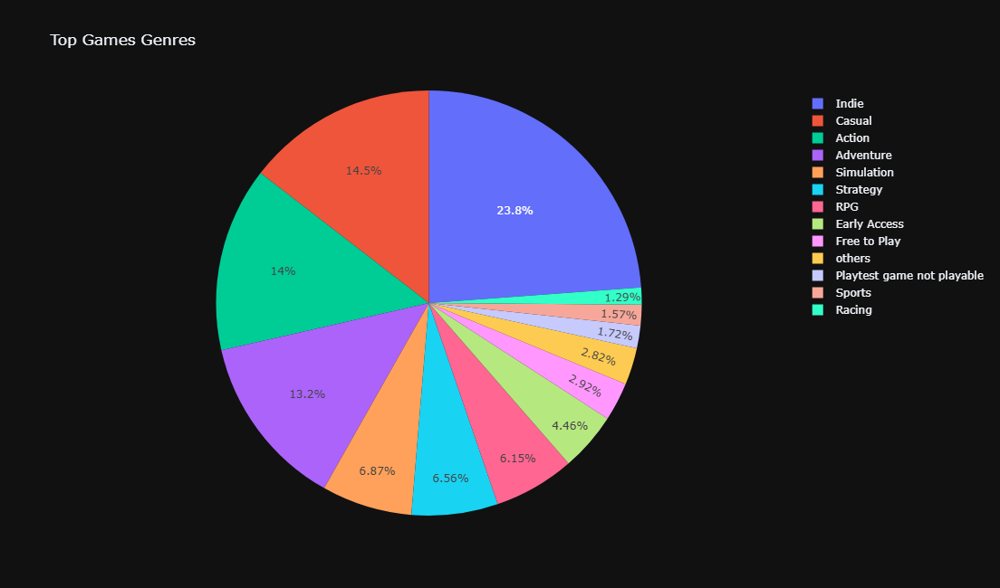

In [452]:
top_Genres_graph = px.pie(pie_chart_genres_count, values='Frequency', names='Genres', title='Top Games Genres').update_layout(width=800,height=650)
top_Genres_graph.show()

### Top 3 Genres by Average downloads 

In [458]:
df_Genres = df[["Name","owners clean","Price","Genres"]].copy()

In [459]:
df_Genres 

,Name,owners clean,Price,Genres
0,Galactic Bowling,10000.0,19.99,"Casual,Indie,Sports"
1,Train Bandit,10000.0,0.99,"Action,Indie"
2,Jolt Project,10000.0,4.99,"Action,Adventure,Indie,Strategy"
3,Henosisâ„¢,10000.0,5.99,"Adventure,Casual,Indie"
4,Two Weeks in Painland,10000.0,0.00,"Adventure,Indie"
...,...,...,...,...
97423,Femdom Game World: Mom,10000.0,4.19,Casual
97424,Blocky Farm,0.0,8.99,"Casual,Simulation,Strategy"
97425,Infiltrate & Extract,0.0,0.00,"Strategy,Free To Play"
97426,Escape The Garage,0.0,4.99,"Adventure,Casual,Indie"


In [460]:
for index, row in df_Genres.iterrows():
    if "Indie" in row["Genres"]:
        df_Genres.at[index , "Indie"] = True
for index, row in df_Genres.iterrows():
    if "Action" in row["Genres"]:
        df_Genres.at[index ,"Action"] = True
for index, row in df_Genres.iterrows():
    if "Casual" in row["Genres"]:
        df_Genres.at[index ,"Casual"] = True

In [461]:
# Average downloads for Indie Genre 
df_Genres.groupby("Indie").agg({"owners clean":"mean"})

,owners clean
Indie,
True,23222.624111


In [462]:
# Average downloads for Action Genre 
df_Genres.groupby("Action").agg({"owners clean":"mean"})

,owners clean
Action,
True,50722.737574


In [463]:
# Average downloads for Casual Genre 
df_Genres.groupby("Casual").agg({"owners clean":"mean"})

,owners clean
Casual,
True,17025.189109


In [471]:
df.columns

Index(['AppID', 'Name', 'Release date', 'Estimated owners', 'Peak CCU',
       'Required age', 'Price', 'Discount', 'DLC count', 'About the game',
       'Supported languages', 'Full audio languages', 'Header image',
       'Support email', 'Windows', 'Mac', 'Linux', 'Metacritic score',
       'User score', 'Positive', 'Negative', 'Achievements', 'Recommendations',
       'Average playtime forever', 'Average playtime two weeks',
       'Median playtime forever', 'Median playtime two weeks', 'Developers',
       'Publishers', 'Categories', 'Genres', 'Tags', 'Screenshots', 'Movies',
       'OS', 'owners clean', 'Free or paid', 'Game have support'],
      dtype='object')

### Most common year in which games were produced

In [474]:
df['year'] = df['Release date'].dt.year

In [476]:
df['year'].unique()

array([2008, 2017, 2021, 2020, 2022, 2014, 2019, 2016, 2018, 2010, 2015,
       2013, 2011, 2007, 2012, 2006, 2009, 2003, 2005, 2004, 2002, 1999,
       1997, 2001, 2000, 1998, 2023, 2025, 2024])

In [478]:
years = df.groupby("year").agg({
    "Name":"count"
}).reset_index()
years.sort_values("Name",ascending = False)

,year,Name
26,2023,15536
25,2022,13979
27,2024,12577
24,2021,12374
23,2020,9628
21,2018,8166
22,2019,7808
20,2017,6324
19,2016,4406
18,2015,2683


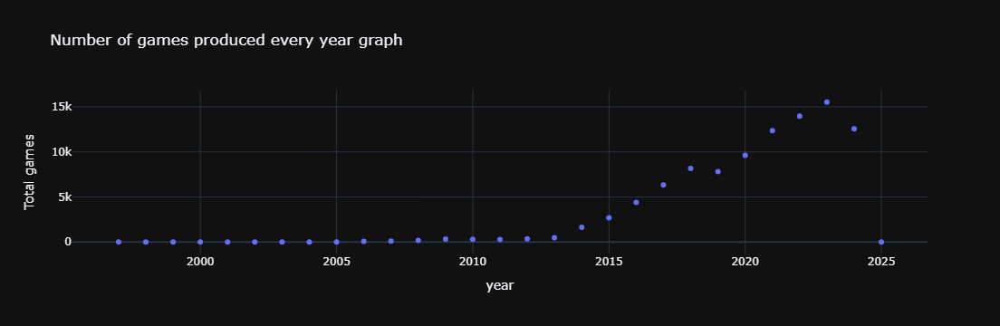

In [480]:
Number_of_games_produced_every_year_graph = px.scatter(years, x="year", y="Name", title='Number of games produced every year graph',
  labels={ "Name": "Total games",})
Number_of_games_produced_every_year_graph.show()

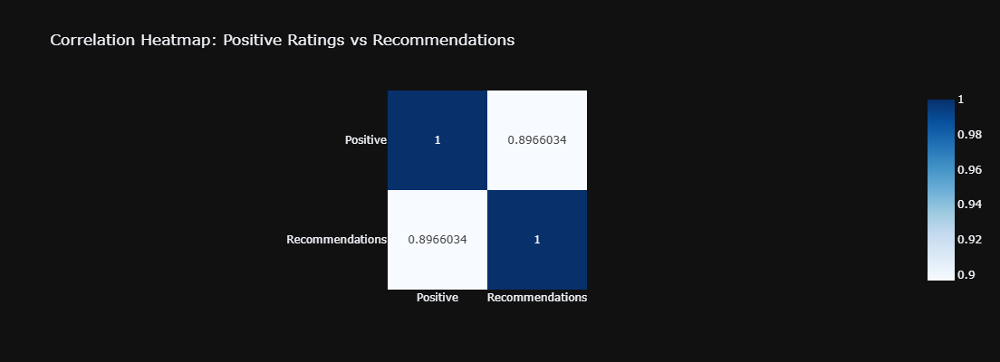

In [481]:
# Calculate the correlation matrix for Average Playtime and Positive Ratings
correlation_positive_recommendations = df[['Positive', 'Recommendations']].corr()
fig1 = px.imshow(correlation_positive_recommendations,
                 text_auto=True,
                 color_continuous_scale='Blues',
                 title='Correlation Heatmap: Positive Ratings vs Recommendations')
fig1.update_layout(width=600, height=400)
fig1.show()

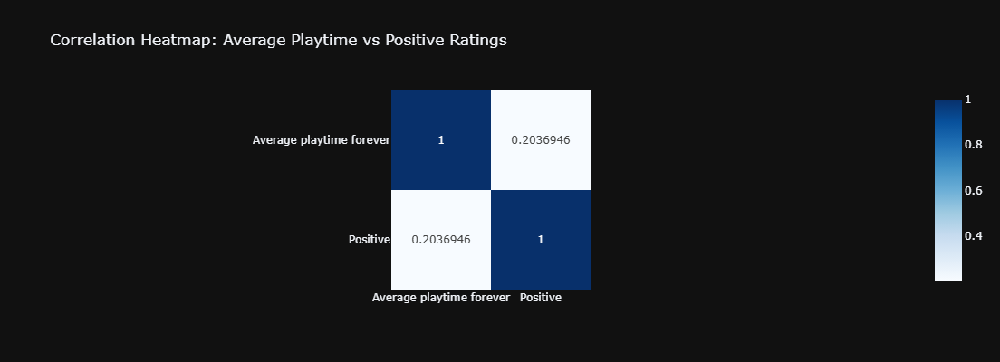

In [484]:
# Calculate the correlation matrix for Average Playtime and Positive Ratings
correlation_playtime_positive = df[['Average playtime forever', 'Positive']].corr()
fig2 = px.imshow(correlation_playtime_positive,
                 text_auto=True,
                 color_continuous_scale='Blues',
                 title='Correlation Heatmap: Average Playtime vs Positive Ratings')
fig2.update_layout(width=600, height=400)
fig2.show()

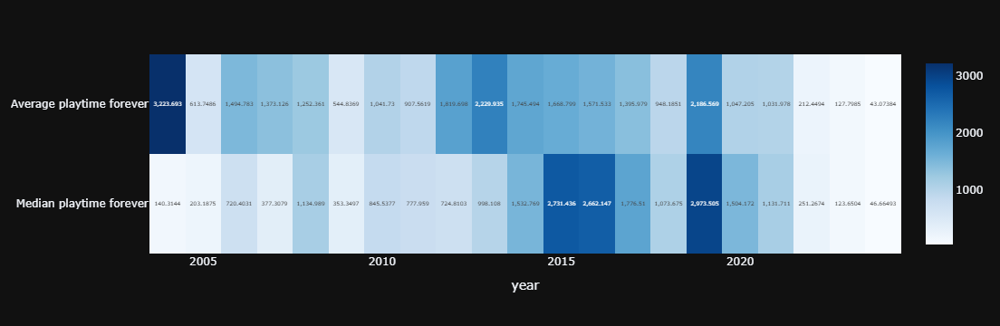

In [488]:
# Standard Deviation of Average and Median Playtime for the Last Two Decades (2004-2024)
playtime_std = df[df['year'].between(2004, 2024)].groupby('year').agg({
    'Average playtime forever': 'std',
    'Median playtime forever': 'std'
}).reset_index()

fig = px.imshow(playtime_std.set_index('year').T, color_continuous_scale='Blues', text_auto=True)
fig.show()


#### Thank you for taking the time to explore my Exploratory Data Analysis (EDA) project. I appreciate your attention and support throughout this journey. If you have any questions or queries, please feel free to reach out.

In [ ]:
# GAME OVER